In [26]:
import logging
import pandas as pd
import numpy as np
from numpy import random
import nltk
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.metrics import accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import re
from bs4 import BeautifulSoup
import os 

In [6]:
data=pd.read_csv('G:/kaggle/url classification/train.csv')
data=data.drop(columns=["Webpage_id","Domain"])
data.shape

(53447, 2)

In [7]:
data.head(10)

,Url,Tag
0,http://www.fiercepharma.com/marketing/tecfider...,news
1,http://www.fiercepharma.com/pharma/novo-equipp...,news
2,http://www.fiercepharma.com/pharma/another-exe...,news
3,http://www.fiercepharma.com/pharma/teva-buy-bi...,news
4,http://www.fiercepharma.com/marketing/actress-...,news
5,http://www.fiercepharma.com/pharma/celgene-s-o...,news
6,http://www.fiercepharma.com/pharma/mylan-takes...,news
7,http://www.fiercepharma.com/marketing/failed-e...,news
8,http://www.fiercepharma.com/pharma/should-gsk-...,news
9,http://www.fiercepharma.com/pharma/drug-pricin...,news


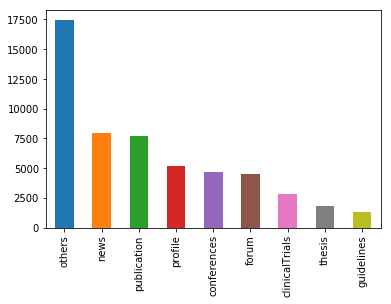

In [8]:
data["Tag"].value_counts().plot('bar')

In [9]:
data['Url'].apply(lambda x: len(x.split(' '))).sum()

53447

In [10]:
def print_plot(index):
    example = data[data.index == index][['Url', 'Tag']].values[0]
    if len(example) > 0:
        print(example[0])
        print('Tag:', example[1])

In [13]:
print_plot(1)

http://www.fiercepharma.com/pharma/novo-equipped-to-weather-storm-u-s-diabetes-market-ceo-says
Tag: news


In [15]:
print_plot(5000)

https://clinicaltrials.gov/ct2/show/NCT02231476?recr=Recruiting&rank=23026
Tag: clinicalTrials


In [16]:
REPLACE_BY_SPACE_RE = re.compile('[/(){}\[\]\|@,;]')
BAD_SYMBOLS_RE = re.compile('[^0-9a-z #+_]')
STOPWORDS = set(stopwords.words('english'))

def clean_text(text):
    """
        text: a string
        
        return: modified initial string
    """
    text = BeautifulSoup(text, "lxml").text # HTML decoding
    text = text.lower() # lowercase text
    text = REPLACE_BY_SPACE_RE.sub(' ', text) # replace REPLACE_BY_SPACE_RE symbols by space in text
    text = BAD_SYMBOLS_RE.sub('', text) # delete symbols which are in BAD_SYMBOLS_RE from text
    text = ' '.join(word for word in text.split() if word not in STOPWORDS) # delete stopwors from text
    return text

In [18]:
data['Url'] = data['Url'].apply(clean_text)

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fiercepharma.com/marketing/tecfidera-gilenya-and-aubagio-s-3-way-battle-for-ms-share-about-to-get-more-interesting" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fiercepharma.com/pharma/novo-equipped-to-weather-storm-u-s-diabetes-market-ceo-says" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fiercepharma.com/pharma/another-exec-departs-troubled-endo-and-time-it-s-for-another-drugmaker" 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.anzctr.org.au/Trial/Registration/TrialReview.aspx?ACTRN=12616000927426p" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.anzctr.org.au/Trial/Registration/TrialReview.aspx?ACTRN=12616000791437" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.anzctr.org.au/Trial/Registration/TrialReview.aspx?ACTRN=12616001395426" looks like a URL. Beautiful Soup is not an HTTP client. You should probably u

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.chictr.org.cn/showproj.aspx?proj=9711" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.isrctn.com/ISRCTN49428666?q=&filters=&sort=&offset=10036&totalResults=15249&page=101&pageSize=100&searchType=basic-search" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.chictr.org.cn/showproj.aspx?proj=13195" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.isrctn.com/ISRCTN38375681?q=&filters=&sort=&offset=10013&totalResults=15249&page=101&pageSize=100&searchType=basic-search" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.isrctn.com/ISRCTN57843703?q=&filters=&sort=&offset=10105&totalResults=15249&page=102&pageSize=100&searchType=basic-search" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.isrctn.com/ISRCTN44212338?q=&filters=&sort=&offset=

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://upload.umin.ac.jp/cgi-open-bin/ctr_e/ctr_view.cgi?recptno=R000030583" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.isrctn.com/ISRCTN66541317?q=&filters=&sort=&offset=6730&totalResults=15249&page=68&pageSize=100&searchType=basic-search" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://upload.umin.ac.jp/cgi-open-bin/ctr_e/ctr_view.cgi?recptno=R000029864" looks like a URL. Beautiful Soup is not an

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://blogs.fda.gov/fdavoice/index.php/2013/07/dietary-supplements-containing-unsafe-food-additive-destroyed/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://blogs.fda.gov/fdavoice/index.php/2013/07/why-fda-proposes-an-action-level-for-arsenic-in-apple-juice/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://blogs.fda.gov/fdavoice/index.php/2013/07/counterfeit-drugs-prosecuting-the-profiteers-protecting-t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.amarincorp.com/releases.cfm?NumberPerPage=15&PageNum=13&ReleasesType=&SortOrder=Date+Ascending&Year=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.amarincorp.com/releases.cfm?NumberPerPage=15&PageNum=4&ReleasesType=&SortOrder=Date+Descending&Year=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.amarincorp.com/releases.cfm?NumberPerPage=15&PageNum=17&ReleasesType=&SortOrde

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.media-newswire.com/release_1095599.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.media-newswire.com/release_1096784.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.media-newswire.com/release_1091987.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Bea

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://finance.yahoo.com/news/retransmission-drill-program-expanded-third-130000089.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.alkaloid.com.mk/news-2011-ns_article-national-award-for-corporate-social-responsibility-granted-to-alkaloid-ad-skopje-for-fairwild-standa.nspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://fr.accuray.com/pressroom/press-releases/addenbrookes-hospital-install-second-

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.anzctr.org.au/Trial/Registration/TrialReview.aspx?ACTRN=12616000993493" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://news.abbvie.com/news/abbvie-demonstrates-commitment-to-continued-research-in-hepatitis-c-with-investigational-data-from-clinical-program-being-presented-at-liver-meeting.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.consumerfinance.gov/about-us/newsroom/cfpb-orders-t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.anzctr.org.au/Trial/Registration/TrialReview.aspx?ACTRN=12615000749505" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.onlineprnews.com/news/804986-1483423151-free-mortgage-advice-in-northern-ireland.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.anzctr.org.au/Trial/Registration/TrialReview.aspx?ACTRN=12615000692538" looks like a URL. Beautiful Soup is not an HTTP client. You sho

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.activebiotech.com/press-releases?pressid=1097891" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.activebiotech.com:443/press-releases?pressid=2058599" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://markets.financialcontent.com/tnj/news/read/17760642" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the UR

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://de.accuray.com/pressroom/press-releases/accuray-hosts-korean-embassys-minister-economic-affairs-event-support-us" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.biologicaldiversity.org/news/press_releases/2013/lead-03-18-2013.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.beyondtrust.com/resources/press-release/identify-potentially-risky-accounts-privilege-discovery-reporting-tool/" lo

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://news.alere.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.cfasingapore.com/events/index.cfm?page=event-description&id=36" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.avid.com/media-composer" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.siemens.com/press/en/presspicture/2017/energymanagement/IM2017010295EMEN.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ir.acorda.com/investors/investor-news/investor-news-details/2007/Acorda-Therapeutics-to-Present-at-the-JPMorgan-26th-Annual-Healthcare-Conference/default.aspx?print=1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.egain.com/company/news/press_releases/egain-positioned

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://newsroom.businesswire.com/in_the_news" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://news.delta.com/boston-logan-international-airport-0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.wyomingnews.com/news/house-committee-advances-bill-allowing-wyoming-hemp-farming/article_638e2cfc-e84b-11e6-9352-b79213375a6f.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use a

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://business.punxsutawneyspirit.com/punxsutawneyspirit/news/read/18830322/SEO_Copywriting_Firm's_Content_Marketing_Mixer_Takes_The_Guesswork_Out_Of_Social_Media_Marketing" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.astellas.com/en/corporate/news/detail/ucb-and-astellas-announce-agre.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://freddiemac.mwnewsroom.com/press-releases/stacr-2016-debt-note

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://spaceflights.news/?tag=soyuz-ms-03" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.surreywildlifetrust.org/news/50" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://media.carcare.org/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautifu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ctri.nic.in/Clinicaltrials/pmaindet2.php?trialid=6978&EncHid=&userName=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ctri.nic.in/Clinicaltrials/pmaindet2.php?trialid=7307&EncHid=&userName=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ctri.nic.in/Clinicaltrials/pmaindet2.php?trialid=5610&EncHid=&userName=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP cl

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.anzctr.org.au/Trial/Registration/TrialReview.aspx?ACTRN=12617000050358" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://en.search.irct.ir/view/20531" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://en.search.irct.ir/view/31560" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to B

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ctri.nic.in/Clinicaltrials/pmaindet2.php?trialid=1173&EncHid=&userName=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ctri.nic.in/Clinicaltrials/pmaindet2.php?trialid=1674&EncHid=&userName=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ctri.nic.in/Clinicaltrials/pmaindet2.php?trialid=1872&EncHid=&userName=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP cl

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.trialregister.nl/trialreg/admin/rctview.asp?TC=6055" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.trialregister.nl/trialreg/admin/rctview.asp?TC=6047" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.trialregister.nl/trialreg/admin/rctview.asp?TC=6044" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.trialregister.nl/trialreg/admin/rctview.asp?TC=3602" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.trialregister.nl/trialreg/admin/rctview.asp?TC=3522" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.trialregister.nl/trialreg/admin/rctview.asp?TC=3441" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.chictr.org.cn/showproj.aspx?proj=14439" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.jp/user/showCteDetailE.jsp?japicId=JapicCTI-121946" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.jp/user/showCteDetailE.jsp?japicId=JapicCTI-111725" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the doc

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.australiancancertrials.gov.au/search-clinical-trials/search-results/clinical-trials-details.aspx?TrialID=335301&ds=1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.australiancancertrials.gov.au/search-clinical-trials/search-results/clinical-trials-details.aspx?TrialID=336759&ds=1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.australiancancertrials.gov.au/search-clinical-trials/search-r

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://en.search.irct.ir/view/21822" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://en.search.irct.ir/view/21757" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://en.search.irct.ir/view/23002" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful S

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.alliedmarketresearch.com/information-and-communication-technology-and-media/high-tech-enterprise-and-consumer-it-market-report" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://events.r20.constantcontact.com/register/event?oeidk=a07edrh8wbmebc6fa7c&llr=naox5fdab" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.apotex.com/global/about/press/20140926.asp" looks like a URL. Beautiful Soup is not a

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cris.nih.go.kr/cris/en/search/search_result_st01.jsp?seq=5283" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cris.nih.go.kr/cris/en/search/search_result_st01.jsp?seq=1371" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cris.nih.go.kr/cris/en/search/search_result_st01.jsp?seq=1331" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.jp/user/showCteDetailE.jsp?japicId=JapicCTI-080526" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.jp/user/showCteDetailE.jsp?japicId=JapicCTI-080566" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.jp/user/showCteDetailE.jsp?japicId=JapicCTI-101118" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client l

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.jp/user/showCteDetailE.jsp?japicId=JapicCTI-173594" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.jp/user/showCteDetailE.jsp?japicId=JapicCTI-101344" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.jp/user/showCteDetailE.jsp?japicId=JapicCTI-101207" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client l

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ctri.nic.in/Clinicaltrials/pmaindet2.php?trialid=8117&EncHid=&userName=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ctri.nic.in/Clinicaltrials/pmaindet2.php?trialid=8744&EncHid=&userName=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ctri.nic.in/Clinicaltrials/pmaindet2.php?trialid=9060&EncHid=&userName=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP cl

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.healthgrades.com/physician/dr-vance-felton-e42ez" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.healthgrades.com/physician/dr-john-capurro-yf49d" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.healthgrades.com/physician/dr-haley-ringwood-ggnjv" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the UR

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://researchers.massgeneral.org/MghProfile.aspx?id=13596" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://researchers.massgeneral.org/MghProfile.aspx?id=10385" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://researchers.massgeneral.org/MghProfile.aspx?id=10710" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, an

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.vitals.com/doctors/Dr_Helene_Price.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.vitals.com/doctors/Dr_Andrea_Coladner.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.vitals.com/doctors/Dr_Brendan_Groarke.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rollitup.org/t/2013-the-year-of-white-led-horticultural-lights.653663/page-2" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rollitup.org/t/monsanto-cannabis-yes-or-no-more-needed-4poll-here-riu-also-ballot-prop.608959/page-3" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rollitup.org/t/advance-nutrients-b52-or-organic-b.576345/page-3" looks like a URL. Beautiful Soup is not an HTTP client. You shou

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://community.beatingbowelcancer.org/forum/390-in-a-bit-of-a-spin" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://community.beatingbowelcancer.org/forum/5156-ct-scan-results-are-in-but-we-have-to-wait-until-monday" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://community.beatingbowelcancer.org/forum/5574-blood-loss" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP c

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forum.melanomainternational.org/mif/viewtopic.php?f=54&t=34932&p=44266&hilit=Tumors" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forum.melanomainternational.org/mif/viewtopic.php?f=62&t=33478&p=35073&hilit=Head" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forum.melanomainternational.org/mif/viewtopic.php?f=54&t=35332&p=45975&hilit=oncology" looks like a URL. Beautiful Soup is not an HTTP client

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://zhyxzz.yiigle.com/CN112137201445/562369.htm?locale=zh_CN" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://zhgzbzz.yiigle.com/CN501113201510/864135.htm?locale=zh_CN" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://zhgzbzz.yiigle.com/CN501113200902/187943.htm?locale=zh_CN" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behi

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.spandidos-publications.com/or/8/3/533" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.spandidos-publications.com/ijmm/16/4/771" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.spandidos-publications.com/or/8/5/1091" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bmcpulmmed.biomedcentral.com/articles/10.1186/1471-2466-12-30" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bmcvetres.biomedcentral.com/articles/10.1186/1746-6148-9-101" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://jitc.biomedcentral.com/articles/10.1186/s40425-015-0077-x" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the docum

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://jbiomedsci.biomedcentral.com/articles/10.1186/1423-0127-19-39" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://biolres.biomedcentral.com/articles/10.1186/s40659-015-0030-y" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://biodatamining.biomedcentral.com/articles/10.1186/s13040-015-0058-0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://molecular-cancer.biomedcentral.com/articles/10.1186/1476-4598-12-124" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://stemcellres.biomedcentral.com/articles/10.1186/s13287-015-0148-4" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://wjso.biomedcentral.com/articles/10.1186/s12957-015-0726-z" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to ge

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bmcinfectdis.biomedcentral.com/articles/10.1186/1471-2334-13-574" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://equityhealthj.biomedcentral.com/articles/10.1186/1475-9276-12-60" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cancerci.biomedcentral.com/articles/10.1186/s12935-014-0111-y" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to ge

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://onlinelibrary.wiley.com/doi/10.1111/j.1442-2042.1998.tb00396.x/abstract;jsessionid=B518E60ACBBE701301CF87E9446447FD.f04t04" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://onlinelibrary.wiley.com/doi/10.1111/j.1749-6632.2003.tb03203.x/abstract;jsessionid=B042936B9079E8E27F637F9ADF7BE316.f01t03" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://onlinelibrary.wiley.com/doi/10.1111/j.1753-6405.2007.00002.x/

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://clinicaltrials.gov/ct2/show/NCT02208466?recr=Recruiting&rank=23694" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://clinicaltrials.gov/ct2/show/NCT02224456?recr=Recruiting&rank=23245" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://clinicaltrials.gov/ct2/show/NCT02215967?recr=Recruiting&rank=23487" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like re

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ecommons.cornell.edu/handle/1813/198" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ipprolifesciences.com/ipprolifesciencesnews/article.php?article_id=3663" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ecommons.cornell.edu/handle/1813/17756" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ecommons.cornell.edu/handle/1813/36199" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ecommons.cornell.edu/handle/1813/37058" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ecommons.cornell.edu/handle/1813/17542" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ecommons.cornell.edu/handle/1813/2123" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ecommons.cornell.edu/handle/1813/12796" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ecommons.cornell.edu/handle/1813/3620" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thesis.library.caltech.edu/691/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thesis.library.caltech.edu/1751/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thesis.library.caltech.edu/2134/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thesis.library.caltech.edu/4065/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thesis.library.caltech.edu/3344/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thesis.library.caltech.edu/3279/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thesis.library.caltech.edu/3984/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thesis.library.caltech.edu/2674/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thesis.library.caltech.edu/3620/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dart-europe.eu/full.php?id=111599" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dart-europe.eu/full.php?id=112148" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dart-europe.eu/full.php?id=1127507" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dart-europe.eu/full.php?id=126360" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dart-europe.eu/full.php?id=1213935" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dart-europe.eu/full.php?id=1195387" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  '

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.globaleventslist.elsevier.com/events/2017/04/western-psychological-association-annual-meeting-2017/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dart-europe.eu/full.php?id=1009332" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.globaleventslist.elsevier.com/events/2018/10/world-congress-of-internal-medicine-wcim-2018/" looks like a URL. Beautiful Soup is not an HTTP client. You should 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://hiv-aids-std.conferenceseries.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.globaleventslist.elsevier.com/events/2017/05/frontiers-in-polymer-science/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://immunology.conferenceseries.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that do

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://biosummit.conferenceseries.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://diabetesmeeting.conferenceseries.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://annualmeeting.conferenceseries.com/nephrologists/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://foodsafety-hygiene.conferenceseries.com/middleeast/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://foodsafety-hygiene.conferenceseries.com/europe/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://nucleicacids.conferenceseries.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to B

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://kobi5.com/news/local-news/local-business-grow-condos-expand-to-eugene-44941/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://naples.floridaweekly.com/news/2014-04-24/pet_tales" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://blog.accelerasolutions.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://de.accuray.com/pressroom/press-releases/2007?page=4" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://de.accuray.com/pressroom/press-releases/accuray-expands-direct-sales-presence-india" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cisco.com/c/en/us/solutions/service-provider/visual-networking-index-vni/index.html?POSITION=Cisco%2blink&COUNTRY_SITE=us&CAMPAIGN=GCI%2b2016&CREATIVE=go%2bURL%2bto%2

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.wallstreetselect.com/wss/news/read/18345276" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.eyefortravel.com/social-media-and-marketing/utilizing-user-generated-content" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.cision.com/us/resources/webinars-events/ccc-uncover-influencers/?utm_medium=referral&utm_source=prnewswireblog&utm_content=webinar&utm_campaign=uncoverinfluencers-prn&CO

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.audiologyonline.com/ce/advanced-bionics/events/details/get-connected-with-naida-23591" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://naples.floridaweekly.com/news/2013-03-14/musings" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.edgemarcenter.org/theater-and-film-events-in-los-angeles/past/rob-shanahan-rock-photo-exhibit-2/" looks like a URL. Beautiful Soup is not an HTTP client. You should

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.limra.com/Events/Conferences/2017/2017_Life_Insurance_Conference.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://newsroom.businesswire.com/office-locations" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.amd.com/en-us/press-releases/Pages/radeon-instinct-2016dec12.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ncbi.nlm.nih.gov/pubmed/20665045" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ncbi.nlm.nih.gov/pubmed/24813302" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ncbi.nlm.nih.gov/pubmed/28071659" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ncbi.nlm.nih.gov/pubmed/23948279" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://vestnik.szd.si/index.php/ZdravVest/article/view/2578" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://endojournals.ru/index.php/ket/article/view/6881" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that documen

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.practicalradonc.org/article/S1879-8500(15)00083-1/pdf" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ascopubs.org/doi/pdf/10.1200/JCO.2014.60.2557" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ascopubs.org/doi/pdf/10.1200/jco.2006.07.4559" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://endojournals.ru/index.php/ket/article/view/7015" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://endojournals.ru/index.php/ket/article/view/4268" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://endojournals.ru/index.php/omet/article/view/6551" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medschat.com/topics/cancer%20patients/3" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medschat.com/topics/cancer%20patients/1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medschat.com/topics/first%20treatment/5" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medschat.com/topics/im%20pretty%20sure/1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medschat.com/topics/iv%20infusions/1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medschat.com/topics/iv%20doses/2" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ncbi.nlm.nih.gov/pubmed/12680511" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://m.arthrex.com/newsroom/company-news/2014/03/11/arthrex-launches-new-surgeon-app-24-7-mobile-access-to-hundreds-of-new-surgical-technique-videos-animations-and-related-science" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://m.arthrex.com/newsroom/discover-arthrex/trip-of-a-lifetime/2017/01/23/trip-of-a-lifetime-tif

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.bloodjournal.org/content/122/21/856" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://meetinglibrary.asco.org/record/105877/abstract" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.endocrine-abstracts.org/ea/0047/ea0047oc50.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://app.core-apps.com/eb2016/abstract/3d8fc50430c5dfa9d8149b6f11a3b6cb" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://meetinglibrary.asco.org/record/71455/abstract" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://app.core-apps.com/eb2016/abstract/3d8fc50430c5dfa9d8149b6f116f4b2f" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the docume

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.jamesbeard.org/events/columbus-oh-2" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://archive.aievolution.com/2015/nkf1501/index.cfm?do=abs.viewAbs&abs=1309" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://archive.aievolution.com/2015/nkf1501/index.cfm?do=abs.viewAbs&abs=1308" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the d

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.omicsonline.org/proceedings/anemia-and-risk-factors-in-haart-naive-and-haart-experienced-hiv-positive-participants-in-south-west-ethiopia-a-comparative-study-19731.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.omicsonline.org/proceedings/vitamin-d-antibodies-in-systemic-sclerosis-patients-antibodies-presence-and-clinical-and-laboratory-correlations-19715.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:28

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://meetinglibrary.asco.org/record/62703/abstract" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://meetinglibrary.asco.org/record/62680/abstract" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://meetinglibrary.asco.org/record/82452/abstract" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://news.delta.com/seattle-tacoma-international-airport-0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://nephrology2014.conferenceseries.net/scientific-program.php?day=2&sid=334&date=2014-06-27" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.aveherald.com/news/ave-maria-news/1598-ave-maria-stories-that-were-wrong-7-years-ago-are-still-wrong.html" looks like a URL. Beautiful Soup is not an HTTP clien

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://thejournalofheadacheandpain.springeropen.com/articles/10.1186/1129-2377-15-S1-G34" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://thejournalofheadacheandpain.springeropen.com/articles/10.1186/1129-2377-15-S1-G32" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://thejournalofheadacheandpain.springeropen.com/articles/10.1186/1129-2377-15-S1-G39" looks like a URL. Beautiful Soup is not an HTTP client. Y

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.un.org/sg/en/content/sg/note-correspondents/2017-01-29/joint-press-statement-au-igad-and-un-consultations-south" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://guidelines.gov/summaries/summary/47570/treatment-of-anemia-in-patients-with-heart-disease-a-clinical-practice-guideline-from-the-american-college-of-physicians" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://guidelines.gov/summaries/sum

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.wiseguyreports.com/sample-request/747860-europe-maritime-satellite-communication-market-report-2016" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.aligntech.com/confirm.cfm?destination=/events.cfm&addFile=902044" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.aligntech.com/confirm.cfm?destination=/releases.cfm&addFile=515067" looks like a URL. Beautiful Soup is not an HTTP cli

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://thejournalofheadacheandpain.springeropen.com/articles/10.1186/1129-2377-15-S1-D58" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://thejournalofheadacheandpain.springeropen.com/articles/10.1186/1129-2377-15-S1-E40" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://thejournalofheadacheandpain.springeropen.com/articles/10.1186/1129-2377-15-S1-J14" looks like a URL. Beautiful Soup is not an HTTP client. Y

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.stfm.org/Conferences/AnnualSpringConference/PastConferences/PastAbstracts,Brochures,Handouts,Videos/2015STFMAnnualConference?m=6&s=13467" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://waojournal.biomedcentral.com/articles/10.1186/1939-4551-6-S1-P180" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.stfm.org/Conferences/AnnualSpringConference/PastConferences/PastAbstracts,Brochures,Handouts,Vi

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jfootankleres.biomedcentral.com/articles/10.1186/1757-1146-4-S1-P51" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jfootankleres.biomedcentral.com/articles/10.1186/1757-1146-4-4" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jfootankleres.biomedcentral.com/articles/10.1186/1757-1146-2-19" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.nice.org.uk/guidance/ng30" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.nice.org.uk/guidance/indevelopment/gid-tag422" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.nice.org.uk/guidance/indevelopment/gid-tag426" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.clinicalguidelines.gov.au/portal/2410/australian-sti-management-guidelines-use-primary-care" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.clinicalguidelines.gov.au/portal/2235/asthma-and-complementary-therapies-information-paper-health-professionals" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.clinicalguidelines.gov.au/portal/2489/australian-sexually-transmitted-infection-and-hiv-

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.clinicalguidelines.gov.au/portal/2415/recipient-assessment-transplantation" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.clinicalguidelines.gov.au/node/3266" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.clinicalguidelines.gov.au/portal/2240/obesity-revised" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the docume

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://abstracts.ncri.org.uk/abstract/bringing-quality-to-life-a-shared-vision-the-quality-improvement-group-in-oncology-and-haematology-clinical-trials-ohct-at-guys-and-st-thomas-foundation-trust/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://abstracts.ncri.org.uk/abstract/detection-of-early-radiation-induced-heart-disease-2/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://abstracts.ncri.org.uk/abstract/

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.neurotalk.org/search.php?searchid=2917233&photoplog_searchinfo=1&photoplog_searchquery=CAPOX" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.neurotalk.org/search.php?searchid=2917233&photoplog_searchinfo=1&photoplog_searchquery=FOLFOX" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.neurotalk.org/search.php?searchid=2917236&photoplog_searchinfo=1&photoplog_searchquery=FOLFOX" looks like

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.neurotalk.org/search.php?searchid=2917314&photoplog_searchinfo=1&photoplog_searchquery=vectibix%2520new%2520drugs" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.stfm.org/Conferences/AnnualSpringConference/PastConferences/2016AnnualSpringConference?m=6&s=16963" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ped-rheum.biomedcentral.com/articles/10.1186/1546-0096-8-18" looks like a URL. Beaut

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.egms.de/static/en/meetings/dgnc2016/16dgnc046.shtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.egms.de/static/en/meetings/dgnc2016/16dgnc081.shtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.egms.de/static/en/meetings/dgnc2016/16dgnc222.shtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cancerandmetabolism.biomedcentral.com/articles/10.1186/2049-3002-2-S1-P43" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcproc.biomedcentral.com/articles/10.1186/1753-6561-6-S3-P48" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cancerandmetabolism.biomedcentral.com/articles/10.1186/2049-3002-2-S1-P5" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://archive.aievolution.com/2015/nkf1501/index.cfm?do=abs.viewAbs&abs=1162" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fertstert.org/article/S0015-0282(13)02547-8/abstract" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.redjournal.org/article/S0360-3016(14)03914-5/fulltext" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://circ.ahajournals.org//content/130/Suppl_2/A13655" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://circ.ahajournals.org//content/130/Suppl_2/A5" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://circ.ahajournals.org//content/130/Suppl_2/A17969" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that docu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://conference.ncri.org.uk/abstracts/2013/abstracts/A83.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://obesity2014.conferenceseries.net/scientific-program.php?day=2&sid=439&date=2014-12-02" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://obesity.conferenceseries.com/2015/scientific-program.php?day=1&sid=1037&date=2015-12-07" looks like a URL. Beautiful Soup is not an HTTP client. You should probably

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicopathology.de/static/en/meetings/dgrh2014/14dgrh087.shtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicopathology.de/static/en/meetings/dgrh2014/14dgrh132.shtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicopathology.de/static/en/meetings/dgrh2014/14dgrh237.shtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like re

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.endocrine-abstracts.org/ea/0049/ea0049ep1438.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://abstracts.ncri.org.uk/abstract/adjuvant-use-of-brachytherapy-in-endometrial-carcinoma-2/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.alzheimer-europe.org/Conferences/Previous-conferences/2015-Ljubljana/Detailed-programme-abstracts-and-presentations/Opening-ceremony" looks like a URL. Beautiful

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cambridge.org/core/journals/journal-of-laryngology-and-otology/article/rare-association-of-leiomyosarcoma-with-squamous-cell-carcinoma-of-the-larynx-two-cases/600E438C175952782CFB732B4B749AE7" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://secure.medicalletter.org/scripts/articlefind.cgi?issue=1197-1198&page=98" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pubs.rsna.org/doi/10.1148/radiology.

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmccellbiol.biomedcentral.com/articles/10.1186/1471-2121-11-93" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmccellbiol.biomedcentral.com/articles/10.1186/1471-2121-14-29" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmccellbiol.biomedcentral.com/articles/10.1186/1471-2121-6-19" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcpediatr.biomedcentral.com/articles/10.1186/1471-2431-14-78" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcpediatr.biomedcentral.com/articles/10.1186/1471-2431-12-79" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcneurol.biomedcentral.com/articles/10.1186/1471-2377-11-149" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://clinicalsarcomaresearch.biomedcentral.com/articles/10.1186/2045-3329-4-14" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://clinicalsarcomaresearch.biomedcentral.com/articles/10.1186/s13569-015-0021-3" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://clinicalsarcomaresearch.biomedcentral.com/articles/10.1186/2045-3329-1-10" looks like a URL. Beautiful Soup is not an HTTP client. You should probably us

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://epigeneticsandchromatin.biomedcentral.com/articles/10.1186/1756-8935-3-12" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://eurjmedres.biomedcentral.com/articles/10.1186/s40001-014-0081-5" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://epigeneticsandchromatin.biomedcentral.com/articles/10.1186/1756-8935-7-16" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP cli

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cjon.ons.org/cjon/12/1/does-therapeutic-touch-help-reduce-pain-and-anxiety-patients-cancer" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.hormones.gr/8444/article/article.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://gut.bmj.com/content/50/5/629.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/abs/10.1177/1534735410376068" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/full/10.1177/1534735414550037" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/full/10.1177/1534735413517744" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the UR

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jbiomedsci.biomedcentral.com/articles/10.1186/1423-0127-20-79" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/abs/10.1177/09680519040100040301" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/abs/10.1177/1753425910370709" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/abs/10.1177/00220345950740040701" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pubs.rsna.org/doi/10.1148/56.1.31?url_ver=Z39.88-2003&rfr_id=ori:rid:crossref.org&rfr_dat=cr_pub%3dpubmed" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jbiol.biomedcentral.com/articles/10.1186/jbiol219" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP cli

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/full/10.1016/J.JHSE.2007.03.007" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/full/10.1177/1753193410394420" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jhoonline.biomedcentral.com/articles/10.1186/s13045-014-0063-7" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document b

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.jnccn.org/content/3/1/105.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://molecularneurodegeneration.biomedcentral.com/articles/10.1186/1750-1326-7-45" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://molecularneurodegeneration.biomedcentral.com/articles/10.1186/1750-1326-3-16" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://retrovirology.biomedcentral.com/articles/10.1186/1742-4690-5-46" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://retrovirology.biomedcentral.com/articles/10.1186/1742-4690-11-34" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://retrovirology.biomedcentral.com/articles/10.1186/1742-4690-11-28" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcsystbiol.biomedcentral.com/articles/10.1186/1752-0509-9-S1-S8" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcproc.biomedcentral.com/articles/10.1186/1753-6561-5-S4-S31" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcbioinformatics.biomedcentral.com/articles/10.1186/1471-2105-13-S19-S9" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like req

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.wjgnet.com/1007-9327/full/v11/i7/1023.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thejns.org/doi/abs/10.3171/2009.1.PEDS08298?url_ver=Z39.88-2003&rfr_id=ori:rid:crossref.org&rfr_dat=cr_pub%3dpubmed" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://haemo.schattauer.de/en/contents/archive/issue/973/manuscript/12006.html" looks like a URL. Beautiful Soup is not an HTTP client. You should pro

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.spiedigitallibrary.org/journals/Journal-of-Biomedical-Optics/volume-15/issue-04/047004/Fiber-optic-multiphoton-flow-cytometry-in-whole-blood-and-in/10.1117/1.3463481.full" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.nejm.org/doi/full/10.1056/NEJMicm980108" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://casesjournal.biomedcentral.com/articles/10.1186/1757-1626-3-20" looks like a URL. Beau

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pharmrev.aspetjournals.org/content/56/1/53.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cjon.ons.org/cjon/16/1/qualitative-analysis-cancer-related-fatigue-ambulatory-oncology" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://iai.asm.org/content/72/3/1746.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://theoncologist.alphamedpress.org/content/12/2/221.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://onf.ons.org/onf/34/6/determining-female-physicians-and-nurses-practices-and-attitudes-toward-breast-self" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.scielo.cl/scielo.php?script=sci_arttext&pid=S0716-97602009000400013&lng=en&nrm=iso&tlng=en" looks like a URL. Beautiful Soup is not an HTTP cli

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.inderscienceonline.com/doi/abs/10.1504/IJBRA.2010.031289?url_ver=Z39.88-2003&rfr_id=ori:rid:crossref.org&rfr_dat=cr_pub%3dpubmed" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://jcs.biologists.org/content/62/1/249.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.jleukbio.org/content/88/1/107.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP clien

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://methods.schattauer.de/en/contents/archivepremium/issue/1267/manuscript/15000.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.eymj.org/DOIx.php?id=10.3349/ymj.2000.41.2.213" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.future-science.com/doi/abs/10.4155/fmc.10.294?url_ver=Z39.88-2003&rfr_id=ori%3Arid%3Acrossref.org&rfr_dat=cr_pub%3Dpubmed" looks like a URL. Beautiful Soup is not an H

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sjweh.fi/show_abstract.php?abstract_id=359" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://link.springer.com/article/10.1007%2Fs10620-005-1605-1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://jn.nutrition.org/content/139/8/1510.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that docu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sjweh.fi/show_abstract.php?abstract_id=2469" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.elis.sk/index.php?page=shop.product_details&flypage=flypage.tpl&product_id=3860&category_id=110&option=com_virtuemart" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://link.springer.com/article/10.1007%2Fs10585-005-6615-z" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use a

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://emboj.embopress.org/content/17/5/1259.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fasebj.org/content/14/9/1083.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://symposium.cshlp.org/content/76/325.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.managedcaremag.com/archives/2005/2/biggest-increases-specialty-drug-costs-seen-rheumatologic-cancer-and-hemophilia" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://secure.medicalletter.org/article-share?a=1370c&p=tml&title=Abiraterone%20Acetate%20(Zytiga)%20for%20Metastatic%20Castration-Resistant%20Prostate%20Cancer&cannotaccesstitle=1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.biochems

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://iv.iiarjournals.org/content/24/6/889.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://jasn.asnjournals.org/content/13/8/2058.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medecinesciences.org/en/articles/medsci/abs/2015/04/medsci20153104p360/medsci20153104p360.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.mja.com.au/journal/2010/193/8/doctors-knowledge-patient-radiation-exposure-diagnostic-imaging-requested" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://sites.ualberta.ca/~csps/JPPS5(1)/M.Mahmoudian/peganum.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.dustri.com/nc/article-response-page.html?artId=12829&doi=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://journals.viamedica.pl/folia_histochemica_cytobiologica/article/view/4383" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://erj.ersjournals.com/content/12/6/1419.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rsta.royalsocietypublishing.org/content/366/1879/3301.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document b

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medicaljournals.se/acta/content/abstract/10.2340/00015555-1340" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.termedia.pl/Journal/-20/Artykul-19883" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://avmajournals.avma.org/doi/abs/10.2460/javma.234.6.743?url_ver=Z39.88-2003&rfr_id=ori:rid:crossref.org&rfr_dat=cr_pub%3dpubmed" looks like a URL. Beautiful Soup is not an HTTP client. You should pr

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://canjsurg.ca/vol45-issue6/45-6-461/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cshperspectives.cshlp.org/content/3/1/a000745.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.e-ceo.org/journal/view.php?id=10.3342/ceo.2010.3.3.153" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that d

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://err.ersjournals.com/content/20/119/034.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.cjcsysu.com/fulltextnew.asp?y=2010&m=8&ym=721" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.cjcsysu.com/fulltextnew.asp?y=2010&m=8&ym=761" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that doc

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.karger.com/Article/FullText/367734" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://brazjurol.com.br/march_april_2013/Wang_189_194.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.jcancer.org/v06p0583.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.hormones.gr/8536/article/article.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bjgp.org/content/62/597/182.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bjgp.org/content/62/594/e29.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that do

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dl.begellhouse.com/journals/4b27cbfc562e21b8,2624a2726bf9b9d7,0305ff485c4662ed.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medicaljournals.se/jrm/content/abstract/10.2340/16501977-0275" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.gastrokorea.org/journal/viewJournal.html?year=2011&vol=58&iss=1&page=9" looks like a URL. Beautiful Soup is not an HTTP client. You should probably 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.hbpdint.com/EN/Y2008/V7/I4/412" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sjweh.fi/show_abstract.php?abstract_id=1949" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ajpregu.physiology.org/content/276/1/R136.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beaut

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jbiol.biomedcentral.com/articles/10.1186/jbiol177" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://err.ersjournals.com/content/19/117/173.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ajplung.physiology.org/content/279/2/L319.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that docum

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://mcr.aacrjournals.org/content/early/2017/08/28/1541-7786.MCR-17-0135" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://mcr.aacrjournals.org/content/early/2017/08/17/1541-7786.MCR-16-0297-T" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://mcr.aacrjournals.org/content/early/2017/08/08/1541-7786.MCR-17-0180" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.activebeat.com/diet-nutrition/6-everyday-foods-that-can-help-prevent-cancer/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.agingcare.com/Questions/aid-needs-to-clean-dad-wont-let-her-430926.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.agingcare.com/questions/mother-tells-terrible-lies-will-not-stop-is-this-dementia-talking-431041.htm" looks like a URL. Beautiful Soup is not an 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://resource-allocation.biomedcentral.com/articles/10.1186/s12962-017-0080-9" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ccforum.biomedcentral.com/articles/10.1186/s13054-017-1805-z" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ccforum.biomedcentral.com/articles/10.1186/s13054-017-1806-y" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pressroom.cancer.org/ShuvalIncomeActivity" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pressroom.cancer.org/CRCmortalityJAMA2017" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pressroom.cancer.org/releases?ite" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.curejoy.com/content/common-myths-about-teeth-and-dental-care/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.curejoy.com/content/good-bad-chewing-gums-pregnancy/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.curejoy.com/content/6-surprising-newborn-reflexes-that-you-dont-know-about/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.drugs.com/clinical_trials/amylyx-pharmaceuticals-doses-first-patient-phase-ii-clinical-trial-amx0035-amyotrophic-lateral-17578.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.drugs.com/news/americans-injuring-themselves-grooming-pubic-hair-66687.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.drugs.com/clinical_trials/rebiotix-announces-first-patient-enrolled-phase-3-clinical

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.emedicinehealth.com/thyroid_cancer_treatment/article_em.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.emedicinehealth.com/cancer_fatigue/article_em.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.emedicinehealth.com/knee_dislocation/article_em.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document beh

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.everydayhealth.com/psoriatic-arthritis/living-with/we-need-more-psoriatic-arthritis-awareness/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.everydayhealth.com/type-2-diabetes/symptoms/having-parent-with-type-2-diabetes-what-know-about-your-risk/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.everydayhealth.com/multiple-sclerosis/living-with/ms-increases-urgency-create-writer-artist

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.healthnutnews.com/in-l-a-you-can-now-use-city-land-for-a-free-vegetable-garden/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.healthnutnews.com/holistic-md-needs-your-help-under-bad-attack/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.healthnutnews.com/pesticide-chemical-spill-kills-tens-of-thousands-of-fish-in-virginia/" looks like a URL. Beautiful Soup is not an HTTP client. You

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://htv.com.pk/news/summer-2017-3-tips-picking-right-sunscreen" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.hss.edu/playbook/a-parents-guide-to-opioid-safety/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://news.medicine.iu.edu/releases/2017/08/michael-weiss-appointment.shtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the d

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ventures.mckesson.com/aledade-create-physician-led-aco-new-jersey/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ventures.mckesson.com/doctors-smart-glasses-using-pokemon-go-medicine/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ventures.mckesson.com/kyruus-ceo-shares-perspective-digital-health-massachusetts/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTT

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.medindia.net/news/overuse-of-tumor-marker-tests-not-necessary-172771-1.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.medindia.net/news/heres-how-to-lower-shingles-risk-in-rheumatoid-arthritis-patients-172606-1.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.medindia.net/news/new-strategy-identifies-the-intergenerational-health-effects-of-daca-172728-1.htm" looks like a URL. Beau

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://articles.mercola.com/sites/articles/archive/2013/06/10/9-unhealthy-foods.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://healthypets.mercola.com/sites/healthypets/archive/2017/08/25/dog-food-recalled-pentobarbital-contamination.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://articles.mercola.com/sites/articles/archive/2017/06/01/tips-tricks-to-address-common-sleep-problems.aspx" looks lik

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.naturalhealth365.com/blood-pressure-hypertension-2341.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://naturalnews.com/2017-08-29-scientists-now-developing-ways-to-turn-human-feces-into-plastic-and-nutrients-is-this-really-our-future.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.naturalhealth365.com/homocysteine-dementia-2340.html" looks like a URL. Beautiful Soup is not an HTTP 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://neurosciencenews.com/facial-recognition-exposure-7407/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.netdoctor.co.uk/healthy-living/mental-health/a28718/exercise-anxiety-depression/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.netdoctor.co.uk/healthy-living/wellbeing/a26303/smartphone-effects-on-brain-health/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably us

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.novonordisk.com/content/Denmark/HQ/www-novonordisk-com/en_gb/home/media/news-details.1208.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.nutrition-and-you.com/radish.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.nutrition-and-you.com/lemon.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.peoplespharmacy.com/2017/09/03/whats-in-your-armpit-aluminum-or-magnesium/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.peoplespharmacy.com/2017/08/17/can-you-trust-fda-device-and-drug-approvals/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.peoplespharmacy.com/2017/08/21/rediscovering-lithium-for-mood-disorders/" looks like a URL. Beautiful Soup is not an HTTP client. You should 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://pro.psychcentral.com/genograms-what-they-are-how-to-do-them" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://pro.psychcentral.com/genograms-what-they-are-how-to-do-them/0020265.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://pro.psychcentral.com/exhausted-woman/2017/08/how-to-know-if-you-are-in-danger/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP cli

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.rxlist.com/abstral-drug.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.rxlist.com/brilinta-drug.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.rxlist.com/adreview-drug.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://mediaroom.sanofi.com/sanofi-appoints-robert-castaigne-as-audit-committee-chairman-2/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sheknows.com/entertainment/articles/1135908/sam-smith-new-music-coming-soon" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sheknows.com/parenting/articles/1135892/how-to-donate-diapers-to-hurricane-harvey-victims" looks like a URL. Beautiful Soup is not an HTTP

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.todaysparent.com/recipes/foods-you-can-put-in-a-thermos/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.todaysparent.com/family/11-ways-to-salvage-a-bad-morning/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.todaysparent.com/baby/royal-baby-names-what-baby-cambridge-will-be-called/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like r

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.uspharmacist.com/article/medication-adherence-declines-for-mi-patients-on-highintensity-statins/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.uspharmacist.com/article/higherdose-nsaids-raise-ami-risk-especially-in-first-month-after-initiation/%20" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.uspharmacist.com/article/prophylactic-vancomycin-helps-prevent-c-diff-infection-in-cancer-

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://wi.mit.edu/programs/teacher/past/2002_2003" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://wi.mit.edu/programs/teacher/contact" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://wi.mit.edu/programs/highschool/schedule" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.


G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://agelab.mit.edu/tweets-raw?page=234" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://agelab.mit.edu/tweets-raw?page=232" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://agelab.mit.edu/tweets-raw?page=238" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that docum

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.youtube.com/user/genometv" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://boston.craigslist.org/search/eee?sale_date=2017-07-14" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://agelab.mit.edu/archive" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that d

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://911-magazine.porsche.com/en/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://2018.alamidwinter.org/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://abc7news.com/business/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % deco

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://aac.asm.org/site/misc/authors.xhtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://abc7news.com/sports/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://abc7news.com/state/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % de

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://acexgroup.net/en/galereya/1776/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://acexgroup.net/en/become-a-partner/?backurl=%2Fen%2Findex.php&register=yes" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://acexgroup.net/en/galereya/1777/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://aeroastro.mit.edu/women-aerospace-symposium/women-aerospace-symposium-agenda" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://aeroastro.mit.edu/faculty-research" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://aeroastro.mit.edu/academics" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that documen

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ajcn.nutrition.org/site/misc/advert.xhtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://aim.bmj.com/pages/thank-you-to-our-reviewers/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://alexion.com/products/soliris-paroxysmal-nocturnal-hemoglobinuria" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://alexion.com/SelectCountry/France.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://allston.wickedlocal.com/photos" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://allston.wickedlocal.com/apps/pbcs.dll/section?category=NEWS&profile=1000075" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that do

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://apps.who.int/trialsearch/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://aob.amegroups.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://aoj.uwpress.org/reports/most-cited" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' %

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://arunachalpradesh.gov.in" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://associationofbreastsurgery.org.uk/education/abs-fellowships/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://associationofbreastsurgery.org.uk/education/breast-surgery-training/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and fee

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://babymhospital.org/campaign.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://babymhospital.org/book-a-health-check-up-package.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://babymhospital.org/anaesthesiology-and-critical-care.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that docu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bjgp.org/page/about" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bjgp.org/search" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bestpractices.diversityinc.com/career-advice/bringing-authentic-self-work/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://blogs.bmj.com/medical-ethics/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://blog.arjohuntleigh.us/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://blogs.bmj.com/case-reports/2016/01/22/how-to-write-a-global-health-case-report/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://businesschampions.org/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cags-accg.ca/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://business.simon.com/retailer-marketing" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % dec

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cco.amegroups.com/issue/archive" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ccn.aacnjournals.org/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cco.amegroups.com/issue/current" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful So

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://classifieds.miamiherald.com/fl/rentals/search" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cloudninemarketing.com?s=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cloudninemarketing.com/about/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cvrisk.mvm.ed.ac.uk/calculator/calc.asp" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cvrisk.mvm.ed.ac.uk/index.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cvi.asm.org/site/misc/contact.xhtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that docu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://e-roj.org/authors/authors.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://easo.org/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://easo.org/category/easo/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup


G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://escapadepr.com/contact/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://eu-acme.org/about-eu-acme/contact/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://eu-acme.org/about-eu-acme/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful So

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://healthnews.uc.edu/suggeststory/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ginasthma.org/committees/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://healthnews.uc.edu/publications/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautifu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://intramurals.mit.edu/rules-policies/handbook/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://im-mmc.synthasite.com/allergology-immunology-section.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://im-mmc.synthasite.com/medical-grand-rounds-2008.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and fee

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://iustiap18.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.angiodynamics.com/ownership-profile.cfm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ir.amagpharma.com/phoenix.zhtml?c=61596&p=irol-analysts" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://jobs.jobvite.com/gettyimages" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://jhppl.dukejournals.org/site/misc/inst_terms.xhtml" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.lww.com/jbjsjournal/_layouts/15/oaks.journals/copyright.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed tha

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://learn.lboro.ac.uk" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://kval.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://kval.com/features/pet-of-the-week" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://main.purelinkav.com/main/index.php?dispatch=pages.view&page_id=16" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://medicc.org/ns/about/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://medind.nic.in/full-text-journals.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://molmed.org/journal/podcasts" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://molmed.org/privacy" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://molmed.org/service" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_marku

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://naco.gov.in/documentsreports" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://naples.floridaweekly.com/pageview/viewer/BestOf" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://naples.floridaweekly.com/articles/cuisine-news/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautifu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://onlinelibrary.wiley.com/journal/10.1002/(ISSN)1469-3178/homepage/Contact.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://onlinelibrary.wiley.com/recommend/to/librarian/doi/10.1002/(ISSN)1469-3178" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://onlinelibrary.wiley.com/journal/10.1002/(ISSN)1744-4292/homepage/contact.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://nursingworld.org/Footer/SiteMap" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://personalizedmedicine.partners.org/Biobank/Contact.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://perspectivesinmedicine.cshlp.org/feedback" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beauti

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ebics.net/events/dr-mark-bedau-distinguished-lecture" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ebics.net/events/dr-roger-kamm-investigator-seminar" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ebics.net/events/dr-michael-levin-investigator-seminar" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://nzshs.org/news/latest-news/item/genital-wart-cases-drop-with-introduction-of-free-vaccine" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://nzshs.org/news/latest-news/item/new-resource-launched-by-new-zealand-aids-foundation" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://med.miami.edu/news/events/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requ

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ki.mit.edu/people/leadership/ha-ngoc" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ki.mit.edu/people/leadership/past" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ki.mit.edu/people/leadership/mackie" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://124.205.33.103:81/ch/reader/more_article_list.aspx?yearID=2014&quarterID=24&column_id=8" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://124.205.33.103:81/ch/reader/view_abstract.aspx?file_no=20142006&flag=1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://124.205.33.103:81/ch/reader/more_article_list.aspx?yearID=2014&quarterID=24&column_id=4" looks like a URL. Beautiful Soup is not an HTTP client. You

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.nccn.org/disclosures/PanelDisclosureList.aspx?GroupId=0&MeetingId=343" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://medicine.yale.edu/news/other-pubs.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://medicine.yale.edu/whr/news/article.aspx?id=15802" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bcs.mit.edu/users/gsh4e" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bcs.mit.edu/users/halilmitedu" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bcs.mit.edu/users/hongyizmitedu" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful So

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.barnesjewish.org/Physicians/Results?id=1016951" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.barnesjewish.org/Physicians/Results?id=11115276" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.barnesjewish.org/Physicians/Results?id=136" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://oregon.providence.org/physician-directory/a/armour-rebecca-l/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://oregon.providence.org/physician-directory/b/barsotti-richard-j/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://oregon.providence.org/physician-directory/b/bergquist-bradley-j/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://oregon.providence.org/physician-directory/a/anagor-chude/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://oregon.providence.org/physician-directory/a/aliabadi-wahle-shaghayegh/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://oregon.providence.org/physician-directory/b/bespaly-michael/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.mercydesmoines.org/find-a-doctor/jessica-lorenz" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.mercydesmoines.org/find-a-doctor/david-mcallister" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.mercydesmoines.org/find-a-doctor/christos-kassiotis" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL,

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.dukehealth.org/find-doctors-physicians/ranee-chatterjee-montgomery-md-mph" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.dukehealth.org/find-doctors-physicians/suzanne-e-dvergsten-md" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.dukehealth.org/find-doctors-physicians/allison-gard-md" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cincinnatichildrens.org/bio/b/kelly-baroch" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cincinnatichildrens.org/bio/c/marcella-cameron" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cincinnatichildrens.org/bio/d/hannah-dsouza" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed tha

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://findadoctor.winchesterhospital.org/physician/laurence-conway-md" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://findadoctor.winchesterhospital.org/physician/barry-ginsberg-md" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://findadoctor.winchesterhospital.org/physician/david-j-lesnik-md" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to g

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://hcavirginia.com/physicians/profile/Ted-R-Abernathy-MD" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://hcavirginia.com/physicians/profile/Carl-J-Belock-DPM" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://hcavirginia.com/physicians/profile/John-M-Daniel-MD" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL,

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://doctors.beaumont.org/provider/Ronald+V+Miller/225518" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://doctors.beaumont.org/provider/Joseph+Chattahi/225777" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://doctors.beaumont.org/provider/Theodore+Schreiber/224298" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the U

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.childrenshospital.vanderbilt.org/directory/profile/lynette-gillis.3157" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.childrenshospital.vanderbilt.org/directory/profile/rachel-lenox-mace.1551" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.childrenshospital.vanderbilt.org/directory/profile/yasmin-west-khan.9310" looks like a URL. Beautiful Soup is not an HTTP client. You should probably 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://findaprovider.nemours.org/details/1285/ernesto-figueroa-urology-deptford-philadelphia-wilmington" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://findaprovider.nemours.org/details/1180/divya-dixit-anesthesiology-wilmington" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://findaprovider.nemours.org/details/1203/arabinda-choudhary-medical_imaging-wilmington" looks like a URL. Beautiful Soup is not an H

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://babymhospital.org/gastro-intestinal-surgery.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://babymhospital.org/health-care-packages.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://babymhospital.org/location.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://seagrant.mit.edu/people_desc.php?usrID=212" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://seagrant.mit.edu/people_desc.php?usrID=227" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://seagrant.mit.edu/people_desc.php?usrID=233" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beauti

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://hsci.harvard.edu/people/thomas-s-kupper-md" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://hsci.harvard.edu/people/calum-macrae-md-phd" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://physician.hackensackumc.org//umc/detail.html?pkid=P1LA0UK5K8" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.unmc.edu/dentistry/faculty/premaraj-t.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.unmc.edu/dentistry/faculty/baker.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.unmc.edu/dentistry/faculty/mundil.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.emoryhealthcare.org/physicians/k/kim-julie-jungah.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.emoryhealthcare.org/physicians/r/rodrigo-irandathy.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.emoryhealthcare.org/physicians/f/fernando-harendra-nirmal.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.houstonmethodist.org/doctor/raziuddin-ahmed/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.houstonmethodist.org/doctor/monty-aghazadeh/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.houstonmethodist.org/doctor/phillipm-aguilar/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://web.mit.edu/nse/people/faculty/bucci.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://nrl.mit.edu/people/frank-warmsley" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://nrl.mit.edu/people/al-queirolo" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that doc

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ncbi.nlm.nih.gov/pubmed/10061599" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ncbi.nlm.nih.gov/pubmed/1006880" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ncbi.nlm.nih.gov/pubmed/10126449" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://uroweb.org/emuc17-using-biomarkers-in-decision-making-for-rcc-treatment/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://picower.mit.edu/decoding-hidden-dreams" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://positivepsychologynews.com/news/amanda-horne/2012090424024" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.rcjournal.com/content/early/recent" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thestir.cafemom.com/parenting_news/207457/kindergartener_suspended_terrorist_threats?ct=in_the_mix_1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://positivepsychologynews.com/news/miriam-ufberg/2007012961" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://positivepsychologynews.com/image-maps/positive-psychology-models" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pmaconsultants.com/projects/market/healthcare/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://positivepsychologynews.com/image-maps/accomplishment" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the U

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://projects.registerguard.com/apf/oregon-sports/index/25/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://projects.registerguard.com/apf/politics/index/25/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://projects.registerguard.com/apf/enter/index/25/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://projects.registerguard.com/support-services/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://projects.registerguard.com/weather/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://projects.registerguard.com/pages/copyright/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://surgicalneurologyint.com/societies/events/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://researchpark.illinois.edu/at-illinois/student-entrepreneurship" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://surgicalneurologyint.com/subscribe-now/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that d

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://themegraphy.com/tag/e-commerce/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://themegraphy.com/tag/free/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://sydney.edu.au/alumni-giving/give.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to B

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://repositories.webometrics.info/en/Ranking_africa" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://researchpark.illinois.edu/career-fair" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://researchpark.illinois.edu/careers" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://saveourwater.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://sydney.edu.au/campus-life/life-in-sydney.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://sageke.sciencemag.org/community/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://sydney.edu.au/study/future-of-work.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://science.mit.edu/research/overview" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://sydney.edu.au/study/education-facilities.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Sou

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://statcounter.com/tumblr/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thestir.cafemom.com/guide/smart_prep_for_baby" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://statcounter.com/drupal/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beau

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thewisc.com/calendar-schedule/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thewisc.com/become-a-wisc-member/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thorax.bmj.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://top25.sciencedirect.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://tophealthnews.net/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://tr.paltalk.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\co

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://us.gsk.com/en-us/behind-the-science/our-people/jamies-story-i-control-my-asthma-it-doesn-t-control-me/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://veterinarymedicine.dvm360.com/clinical-pathology" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://us.gsk.com/en-us/careers/working-at-gsk/employee-health-safety-and-well-being/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://veterinarymedicine.dvm360.com/site-map" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://videocenter.myosure.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://video.foxnews.com/v/5588586513001/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://vjge.org/jvi.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://vms.mit.edu/outreach-contact" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://tvscn.nhs.uk/login/?reauth=1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % dec

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://tvscn.nhs.uk/networks/cardiovascular-stroke-renal-diabetes/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://tvscn.nhs.uk/networks/cardiovascular-stroke-renal-diabetes/resources/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://tvscn.nhs.uk/networks/cardiovascular-stroke-renal-diabetes/cardiac/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.fiercepharma.com/animal-health/veterinarian" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.cartus.com/en/contact-us/language-trainers/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.acumed.net/products/hand-wrist" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Bea

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://newsroom.businesswire.com/about_us" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://newsroom.businesswire.com/awards" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://newsroom.businesswire.com/business-highlights" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cardiac.conferenceseries.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cardiothoracic.conferenceseries.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cancer.global-summit.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www1.apotex.com/global/business-opportunities/international-business-development-opportunities" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://news.aptar.com/beauty-home/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www1.apotex.com/global/healthcare-professionals" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.acumed.net/about-acumed/innovate-us" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.acumed.net/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bhs.econ.census.gov/bhs/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.'

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://biomedical.conferenceseries.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bioinformatics.conferenceseries.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cosmeticdermatology.conferenceseries.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.rcpath.org/about-the-college/governance.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.pharmiweb.com/Default.asp?channel=1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://molecular-cancer-biomarkers.conferenceseries.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that docum

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bio.org/insights/multimedia" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://immunologycongress.conferenceseries.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cmeregistration.hms.harvard.edu/events/EventRsvp.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beauti

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.stfm.org/About/BecomeaMember" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.uottawa.ca/graduate-studies/programs-admission/apply" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://neuroradiology.conferenceseries.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautif

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.myhealthtalent.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://iu.cloud-cme.com/aph.aspx?P=20" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.stfm.org/Foundation/LelandBlanchardLecture" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that docume

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cancerscience.conferenceseries.com/poster-presentation.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://informa.com/investors/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.eshre.eu/Home/About-us.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://community.babycenter.com/post/a59049382/2ww-cold_feet_and_back_pain...thats_it" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://community.babycenter.com/post/a48985105/-_stressed_ivf" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://community.babycenter.com/post/a59096944/choromosome_testing" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.babymed.com/fertility-news/how-infertility-affects-female-identity" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://community.babycenter.com/post/a67596460/freeze-low-quality-eggs-hope-for-better-technology" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.babymed.com/fertility-news/study-suggests-bpa-linked-miscarriage" looks like a URL. Beautiful Soup is not an HTTP client. You should proba

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.babymed.com/news-fertility-news/impact-of-acupuncture-infertility" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bellybelly.com.au/forums/conception-general-discussion-76/i-am-going-nuts-help-18912/?s=65aaf93e1c23ff021484d5b5ec0d7ff2" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.babymed.com/fertility-news/parent-attitude-and-fertility-preservation-young-male-cancer-patients" looks l

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bellybelly.com.au/forums/conception-general-discussion-76/missed-period-92892/?s=65aaf93e1c23ff021484d5b5ec0d7ff2" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.babymed.com/fertility-news/restorative-proctocolectomy-impairs-fertility-and-pregnancy-outcome" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.babymed.com/fertility-news/exposure-pesticides-linked-greater-risk-endometriosis" l

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bellybelly.com.au/forums/conception-general-discussion-76/if-u-had-implantation-bleding-lasted-week-when-did-u-get-positive-hpt-113618/?s=65aaf93e1c23ff021484d5b5ec0d7ff2" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.babymed.com/fertility-news/sperm-coating-could-be-cause-of-male-infertility" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.babymed.com/fertility-news/aspirin-or-other-t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bellybelly.com.au/forums/opks-hpts-other-home-tests-discussion-103/reading-hpt-after-time-limit-48947/?s=65aaf93e1c23ff021484d5b5ec0d7ff2" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bellybelly.com.au/forums/opks-hpts-other-home-tests-discussion-103/pregnancy-signs-42418/?s=65aaf93e1c23ff021484d5b5ec0d7ff2" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bellybelly.com.au/forums/opks

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cgbabyclub.co.uk/our-community/forums/mums/nutrition-and-feeding/bottle-to-beaker-3755" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cgbabyclub.co.uk/our-community/forums/mums/nutrition-and-feeding/how-much-milk-3158" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cgbabyclub.co.uk/our-community/forums/mums/weaning/when-to-start-my-6-month-old-on-3-meals-44627" looks like a URL. Beaut

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dontcountyoureggs.typepad.com//blog/2015/08/finding-equilibrium-.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dontcountyoureggs.typepad.com//blog/2015/08/shes-yanking-on-her-ears.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dontcountyoureggs.typepad.com//blog/2015/07/figuring-things-out.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP clien

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dreamingofdiapers.com/2015/10/14/youve-won-the-lottery/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.eumom.ie/forums/topic/jenny-renny-or-cheri/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dreamingofdiapers.com/2013/11/19/egg-retrieval-set-trigger-tonight/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behi

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://blogandforum.fairfaxcryobank.com/forum/archive/index.php/t-4591-p-2.html?s=f0638cb9faa7d4ca5dce3065b51bf313" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.eumom.ie/forums/topic/thinking-of-getting-pregnant-yesno/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.eumom.ie/forums/topic/struggling-to-have-a-lot-of-sex-to-get-pregnant/" looks like a URL. Beautiful Soup is not an HTTP client. You

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.eumom.ie/forums/topic/meet-eumoms-moderators-7/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.fertilityauthority.com/blogger/suzanne-rico/2012/5/10/survival-sex-selected" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://fertilitylabinsider.com/2010/11/risks-to-health-and-fertility-from-everyday-chemicals-legislation/" looks like a URL. Beautiful Soup is not an HTTP client. You should probab

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.fertilityauthority.com/blogger/ellenglazer/2010/10/20/adoption-myth-no-3" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fertilityzone.co.uk/index.php?page=Thread&threadID=46537&s=2e74370aa7346db97f50f4814130501217bbef4a" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fertilitynz.org.nz/forums/trying-conceive/where-here/" looks like a URL. Beautiful Soup is not an HTTP client. You should

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fertilitynz.org.nz/forums/trying-conceive/help-low-hcg/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.fertilityauthority.com/blogger/mrsemmons/2009/07/21/he-therefore-i-am" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fertilitynz.org.nz/forums/trying-conceive/this-is-the-start-to-our-journey...../" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTT

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.fertilityauthority.com/blog/sarah-clark/2014/10/31/could-your-sugar-addiction-contribute-your-infertility" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://fertilitylabinsider.com/2012/06/ivf-horizons-microfluidics/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fertilityzone.co.uk/index.php?page=Thread&threadID=45130&s=2e74370aa7346db97f50f4814130501217bbef4a" looks like a URL. Beautiful Sou

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://inconceivable12.wordpress.com/2016/06/15/returning-home/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.fertilityzone.co.uk/index.php?page=Thread&threadID=46411&s=2e74370aa7346db97f50f4814130501217bbef4a" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://inconceivable12.wordpress.com/2016/05/23/alternate-routes/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an H

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://inconceivable12.wordpress.com/2014/10/06/microblog-mondays-feeling-like-a-grown-up/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://inconceivable12.wordpress.com/2014/09/13/egg-retrieval-and-sundries/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://inconceivable12.wordpress.com/2014/09/08/microblog-mondays-swollen-ovaries/" looks like a URL. Beautiful Soup is not an HTTP client. You should probabl

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.ivfforums.gr/k2-tags/ivf-moms-magazine/sex-and-relationships/item/968-sxeseis-kai-sxetizomai" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.ivfforums.gr/k2-tags/ivf-moms-magazine/sex-and-relationships/item/982-kai-tote-tin-xorisa" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.ivfforums.gr/ivf-moms-magazine/beauty/item/837-metaferontas-trixes" looks like a URL. Beautiful Soup is not an H

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://blog.ivf.com.au/embryoscope-latest-early-stage-embryo-development" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.ivfconnections.com/forums/entry.php/102-To-Adopt-or-not-to-Adopt?s=23e62ada4555fa6326d65976423cf427" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://blog.ivf.com.au/i-already-have-child-so-why-cant-i-fall-pregnant-again" looks like a URL. Beautiful Soup is not an HTTP client. You sho

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://infertilityhonesty.com/2017/03/31/involuntary-childlessness-in-the-human-conversation/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://infertilityhonesty.com/2017/03/08/emotional-labor-misconceptions/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://infertilityhonesty.com/2016/12/05/where-am-i/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requ

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.netmums.com/coffeehouse/advice-support-40/ttc-support-fertility-conception-difficulties-39/147610-trying-concieve.html?s=532484c85ab4b8090dbf81c0f8ab9dd7" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.netmums.com/coffeehouse/advice-support-40/ttc-support-fertility-conception-difficulties-39/149570-hi-newbie-trying-conceive.html?s=532484c85ab4b8090dbf81c0f8ab9dd7" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.ivfforums.gr/ivf-journey/birth-stories/item/540-ai-sto-kalo-egina-mana" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.ivfforums.gr/ivf-journey/birth-stories/item/608-ti-borei-na-se-didaksei-ena-tosodouliko" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.ivfforums.gr/ivf-journey/birth-stories/item/924-kalosorises-magoulitsa" looks like a URL. Beautiful Soup is not an HTTP client. You shou

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.netmums.com/coffeehouse/advice-support-40/ttc-support-fertility-conception-difficulties-39/1473879-help-please.html?s=532484c85ab4b8090dbf81c0f8ab9dd7" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://nokiddinginnz.blogspot.in/2015/06/microblogmondays-dont-waste-our-lives.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://nokiddinginnz.blogspot.in/2014/02/a-head-full-of-thoughts.html" looks like

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.netmums.com/coffeehouse/advice-support-40/ttc-support-fertility-conception-difficulties-39/1625059-difficaulty-conceiving.html?s=532484c85ab4b8090dbf81c0f8ab9dd7" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forums.pkdconnection.org./viewtopic.php?f=3&t=22569&sid=2d152e2d416683affbbf33262db75072" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forums.pkdconnection.org./viewtopic.php?f=3&t=22604

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.shadygrovefertility.com/blog/treatments-and-success/egg-freezing-success-rates/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forums.pkdconnection.org./viewtopic.php?f=9&t=183&sid=b766bdbe31c6ba90df0050d5e858da34" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forums.pkdconnection.org./viewtopic.php?f=9&t=139&sid=b766bdbe31c6ba90df0050d5e858da34" looks like a URL. Beautiful Soup is not an HTTP

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://singaporemotherhood.com/forum/threads/marriage-help.198744/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://singaporemotherhood.com/forum/threads/wharton-preschool-amk-review.64225/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://singaporemotherhood.com/forum/threads/infant-care-baby-haven-pats-schoolhouse.3503/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HT

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://singaporemotherhood.com/forum/threads/any-mummies-here-is-aranda-country-club-member.106214/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://singaporemotherhood.com/forum/threads/routines-to-train-newborns-to-share-help.109334/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://singaporemotherhood.com/forum/threads/oscar-test.94090/" looks like a URL. Beautiful Soup is not an HTTP client. You should 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.whattoexpect.com/forums/fertility-treatments/topic/first-iui-failed-advice-for-next.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.whattoexpect.com/forums/fertility-treatments/topic/fet-lining-issues-need-help-nbsp.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.whattoexpect.com/forums/fertility-treatments/topic/travel--zika.html" looks like a URL. Beautiful Soup is not an H

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://whenyoucanthavekids.blogspot.in/2012/01/my-funeral.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.whattoexpect.com/forums/fertility-treatments/topic/i-got-my-bfp-on-clomid-yesterday.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://whenyoucanthavekids.blogspot.in/2011/05/mothers-day.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cardiac.pharmaceuticalconferences.com/events-list/cardiovascular-diseases-diagnosis" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.investor.jnj.com/releases.cfm?NumberPerPage=10&ReleasesType=&SortOrder=Date+Ascending&year=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.investor.jnj.com/releases.cfm?NumberPerPage=10&PageNum=160&ReleasesType=&SortOrder=Date+Descending&Year=" looks like a URL

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.mskcc.org/event/caregivers-group-three-rs-self-care-rest-relaxation-rejuvenation" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cardiac.pharmaceuticalconferences.com/events-list/clinical-cardiology" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.investor.jnj.com/releasedetail.cfm?ReleaseID=376951" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP clien

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://en.sanofi.com/investors/indiv_shareholders/events/2012_events/2012_events.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.takeda.com/what-we-do/research-and-development/takeda-clinical-trial-transparency/summary-result-information/?page=5" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.abbvie.com/phoenix.zhtml?EventId=5109354&c=251551&p=irol-EventDetails" looks like a URL. Beauti

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://advancedpharmacy.pharmaceuticalconferences.com/events-list/pharmaceutical-analysis" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://press.bayer.com/baynews/baynews.nsf/id/Speeches" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://press.bayer.com/baynews/baynews.nsf/id/Speeches?opendocument=&s1=1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like request

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://biopharmaceutics.pharmaceuticalconferences.com/2015/recommended-global-conferences.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://biopharmaceutics.pharmaceuticalconferences.com/2015/eposter-presentation.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://antibiotics.pharmaceuticalconferences.com/usa/events-list/antimicrobial-resistance-emergence-and-its-eccentricity" looks like a URL. Beautif

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ca.gsk.com/en-ca/media/press-releases/2013/gsk-launches-global-consortium-with-six-renowned-cancer-research-centres/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.vectorcontrol.bayer.com/Media-and-News/2017/01/The-War-on-Mosquitoes-Bayer-research-magazine" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sanofipasteur.com/en/media/local-press-releases/archives_2015/" looks like a URL. Beauti

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.iraq.cropscience.bayer.com/en/News/2014/New-visual-identity-for-Nunhems.aspx?overviewId=6749967A-D181-4552-8C71-B1CE33180721" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.iraq.cropscience.bayer.com/en/News/2014/New-visual-identity-for-Nunhems.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.iraq.cropscience.bayer.com/en/News/2012/Mondose.aspx?overviewId=6749967A-D181-4552-8C71-B1

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.gene.com/media/news-features/genentech-at-asco-2012" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.gene.com/media/press-releases/12147/2009-05-29/avastin-plus-commonly-used-chemotherapie" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.gene.com/media/news-features/genentech-gives-back-week-2012" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP cli

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.iwm.bayer.com/news-and-media/stories-from-the-field/stories-from-the-field-container/2017/04/19/12/18/06_richard_hinchliffe" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ssl.bayer.com/baynews/baynews.nsf/id/Keep-your-family-healthy-by-protecting-your-pet-from-parasites?Open=&ccm=020&parent=news-overview-category-search-en" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.chugai-pharm.co.jp

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://news.abbvie.com/news/abbvie-to-present-at-evercore-isi-2017-biopharma-catalystdeep-dive-conference.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://row.grifols.com/en/web/rest-world/view-news/-/new/grifols-contributes-to-river-restoration-projects" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://newsroom.regeneron.com/releasedetail.cfm?releaseid=621335" looks like a URL. Beautiful Soup is not an H

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.abbvie.com/phoenix.zhtml?ID=2289846&c=251551&p=irol-newsArticle_Print" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.abbvie.com/phoenix.zhtml?ID=2285296&c=251551&p=irol-newsArticle_Print" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.abbvie.com/phoenix.zhtml?ID=2282608&c=251551&p=irol-newsArticle_Print" looks like a URL. Beautiful Soup is not an HTTP client. You should

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.ono.co.jp/eng/cn/contents/sm_cn_1224992.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://media.biogen.com/print/node/23" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.ono.co.jp/eng/cn/contents/sm_cn_072302.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.leo-pharma.com/Home/LEO-Pharma/Media-centre/News/News-2015/LEO-Pharma-announces-new-global-leadership.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.mallinckrodt.com/about/news-and-media/2104609" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://my.gsk.com/en-gb/media/press-releases/2016/bersama-melawan-denggi-initiates-nation-empowerment-to-help-defeat-dengue/" looks like a URL. Beautiful

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.mallinckrodt.com/about/news-and-media/2310164" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://apac.grifols.com/en/web/asia-pacific/view-news/-/new/sippet-an-international-randomized-study-reports-87-higher-incidence-of-inhibitors-with-recombinant-factor-viii-in-patients-with-severe-hemophilia-a" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.mallinckrodt.com/about/news-and-media/2280748" look

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cancer.gov/publications/patient-education/wyntk-leukemia" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cancer.gov/publications/patient-education/wyntk-breast-cancer" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.jimmyfund.org/events/organize-an-event/event-manager-center/templates-and-samples/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP cl

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ohmytinylittlepeahead.com/2015/08/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ohmytinylittlepeahead.com/2013/06/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ohmytinylittlepeahead.com/2014/10/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that do

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cancer.gov/about-cancer/treatment/drugs/penile" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cancer.gov/about-cancer/treatment/drugs/vulvar" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cancer.gov/about-cancer/treatment/drugs/brain" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and fe

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://msbuller.blogspot.com/2014/08/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://msbuller.blogspot.com/2011/10/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.jimmyfund.org/events/cancer-fundraising-events/swim-across-america---boston-harbor-island-swim/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL,

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.hopkinsmedicine.org/education/graduate-programs/student-life/student-groups/index.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.danafarberbostonchildrens.org/conditions/brain-tumor.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.danafarberbostonchildrens.org/for-physicians/fellowship-overview/pediatric-neuro-oncology-clinical-fellowship.aspx" looks like a URL. Beautiful Soup 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.childrenshospital.org/centers-and-services/centers/cancer-and-blood-disorders-center/overview" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.childrenshospital.org/news-and-events/research-and-innovation-features/immune-molecules-fine-tune-brain-circuits" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.hopkinsmedicine.org/directions/johns_hopkins_at_wyman_park.html" looks like a URL. Beau

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://giving.mskcc.org/membership-recognition" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://giving.mskcc.org/host-your-own-event" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://giving.mskcc.org/msk-login" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that doc

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.mskcc.org/departments/epidemiology-biostatistics/health-outcomes" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.hopkinsmedicine.org/patient_care/billing-insurance/insurance/index.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.mskcc.org/departments/epidemiology-biostatistics/epidemiology" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP clie

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://openwetware.org/wiki/CH391L/S13" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.nhlbi.nih.gov/grants-and-training/funding-opportunities-and-contacts" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.nhlbi.nih.gov/health-topics/peripheral-artery-disease" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://aac.asm.org/content/60/3/1274" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ucsfhealth.org/conditions/heart_failure/index.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ucsfhealth.org/conditions/heart_disease/index.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that docum

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.accuray.com/phoenix.zhtml?c=177244&p=irol-news&nyo=0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ep.bmj.com/pages/authors/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://analysis.pharmaceuticalconferences.com/events-list/chromatography" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and f

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.jneurosci.org/content/about-jneurosci" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.jneurosci.org" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.jneurosci.org/content/information-authors" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that docu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://jmmcr.microbiologyresearch.org/content/journal/jmmcr/news" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://archivesphysiotherapy.biomedcentral.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcpalliatcare.biomedcentral.com/about" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://capmh.biomedcentral.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://physoc.onlinelibrary.wiley.com/hub/journal/10.1002/(ISSN)2051-817X/about/contact-us.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pmj.bmj.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautifu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://head-face-med.biomedcentral.com/about" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://eurapa.biomedcentral.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://equityhealthj.biomedcentral.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.e-aps.org/about/sitemap.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://nutritionj.biomedcentral.com/submission-guidelines" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.e-aps.org/about/open_access.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Sou

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.fic.nih.gov/About/Pages/default.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.fic.nih.gov/News/viewpoints/Pages/default.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.healio.com/endocrinology" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful S

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.canjurol.com/abstract.php?ArticleID=895&version=1.0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.quarterly-report-2016-q2.bayer.com/notes/explanatory-notes/accounting-policies/print.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.quarterly-report-2016-q2.bayer.com/notes/explanatory-notes/legal-risks/print.html" looks like a URL. Beautiful Soup is not an HTTP client. You should pro

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ons.org/member-center/volunteer/oncc-editorial-board" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://canjurol.com/abstract.php?ArticleID=2214&version=1.0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://canjurol.com/abstract.php?ArticleID=1225&version=1.0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the UR

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.canjurol.com/abstract.php?ArticleID=1267&version=1.0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.plos.org/plosmedicine/article?id=10.1371%2Fjournal.pmed.1000237" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://transparency.bayer.com/CH?language=en" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ie.gsk.com/ie/contact-us/consumerspatients/consumer-relations/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ie.gsk.com/ie/contact-us/gsk-worldwide/ghana/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://sequencing.roche.com/en/healthcare-providers/nipt/resources.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document beh

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.annualreport2014.bayer.com/en/earnings-performance-of-bayer-ag.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.annualreport2014.bayer.com/en/financial-management-of-the-group.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.annualreport2014.bayer.com/en/value-management.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like reque

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ie.gsk.com/ie/research/trials-in-people/clinical-trial-phases/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://career.bayer.cn/job/Area-Sales-Manager--SF11381.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ie.gsk.com/ie/responsibility/our-behaviour/research-practices/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the docume

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.vectorcontrol.bayer.com/Training-and-Education/Vectors/Mosquitoes" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sanofipasteur.com/en/about_us/corporate_websites/default.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sanofipasteur.com/en/commitment/access_to_vaccines/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to g

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.endo.com/sec-filings/sec-filing/8-k12b/0001193125-14-077873" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.vectorcontrol.bayer.com/Media-and-News/2013/11/Bayer-and-IVCC-collaboration" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sanofipasteur.com/en/vaccine_essentials/development_of_vaccines/Safety_and_Efficacy/default.aspx" looks like a URL. Beautiful Soup is not an HTTP client.

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.vectorcontrol.bayer.com/Media-and-News/2012/05/LifeNet-at-the-SETAC" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.endo.com/events/event-details/q2-2013-endo-health-solutions-inc-earnings-conference-call" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.vectorcontrol.bayer.com/Media-and-News/2012/05/India-prepares-for-a-rise" looks like a URL. Beautiful Soup is not an HTTP client. Y

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.quarterly-report-2016-q3.bayer.com/management-report/financial-position/liquid-assets-and-net-financial-debt.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.endo.com/company-tear-sheet?field_nir_sec_cik_value=&order=field_nir_sec_form&sort=desc" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.quarterly-report-2016-q3.bayer.com/management-report/financial-position/asset-and-capita

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.news.bayer.com/baynews/baynews.nsf/id/Photos?opendocument=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://innovate.bayer.com/what-we-offer/center-of-expertise-in-tropical-agriculture/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.endo.com/sec-filings/sec-filing/4/0001209191-17-006348" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.annualreport2016.bayer.com/magazine/fighting-cancer/print.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.annualreport2016.bayer.com/to-our-stockholders/chairman-s-letter/print.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.vectorcontrol.bayer.com/Media-and-News/2013/12/WHO-World-Malaria" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP c

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.quarterly-report-2016-q3.bayer.com/servicepages/contact.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.quarterly-report-2016-q3.bayer.com/management-report/sales-earnings-and-financial-position.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.annualreport2016.bayer.com/management-report-annexes/report-on-economic-position/asset-and-financial-position-of-the-bayer-group/asset-and

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://innovate.bayer.com/what-we-offer/grants4traits/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.csl.com/research-and-development/clinical-studies/research-practices" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.csl.com/research-and-development/what-is-a-clinical-trial" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://reports.emdgroup.com/2016/cr-report/facts-figures/indicators/products.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.radiologysolutions.bayer.com/products/mr/injection/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.radiologysolutions.bayer.com/products/molecularimaging/intego/?accodianSection=Featured&videoSelection=VirtualDemo" looks like a URL. Beautiful Soup is not an HTTP client

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.radiologysolutions.bayer.com/products/mr/contrast/gadavist/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jobs.merck.com/go/Medical-Affairs-and-Medical-Doctor-Jobs/3534900/?q=&sortColumn=sort_department&sortDirection=desc" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jobs.merck.com/search/?locale=en_US" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.gsk.com/en-gb/contact-us/worldwide/georgia/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.mylan.com/events.cfm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investor.mylan.com/alerts.cfm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that do

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jobs.merck.com/go/Engineering-Jobs/3534500/?q=&sortColumn=sort_location&sortDirection=desc" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jobs.merck.com/go/Engineering-Jobs/3534500/?q=&sortColumn=sort_title&sortDirection=desc" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jobs.merck.com/go/Engineering-Jobs/3534500/?q=&sortColumn=sort_department&sortDirection=desc" looks like a URL. Beautiful Sou

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.lupin.com/lupin-launches-generic-activella-tablets-in-the-us.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.lupin.com/lupin-launches-novel-injectable-iron-formulation-under-brand-names-isofer-and-jilazo-in-india.php" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.lupin.com/lupin-receives-eir-from-us-fda-for-goa-march-2016-inspection.php" looks like a URL. Beautiful Soup is not an HTT

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.quarterly-report-2017-q2.bayer.com/management-report/business-development/animal-health/print.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jobs.merck.com/go/Research-Science-Jobs/3535200/200/?q=&sortColumn=referencedate&sortDirection=desc" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jobs.merck.com/go/Research-Science-Jobs/3535200/100/?q=&sortColumn=referencedate&sortDirection=desc" l

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://lillypad.lilly.com/entry.php?e=8367" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://lillypad.lilly.com/entry.php?e=7767" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://lillypad.lilly.com/entry.php?e=10227" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' tha

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://job-search.astrazeneca.com/job/charlotte/respiratory-biologic-sales-specialist-charlotte-nc/7684/6449976" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://corporate.qiagen.com/about-us/global-presence?sc_lang=en" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://corporate.qiagen.com/about-us/global-presence?sc_lang=fr-FR" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use a

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://corporate.qiagen.com/about-us/Sustainability/economic-progress?sc_lang=fr-FR" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://lillypad.lilly.com/entry.php?e=10135" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://corporate.qiagen.com/investor-relations/at-a-glance/key-figures?sc_lang=en" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to ge

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ferring.com/en/collaborate-with-us/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ferring.com/en/collaborate-with-us/why-collaborate-with-us/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ferring.com/en/working-at-ferring/vacancies/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and f

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.career.bayer.com/en/career/working-at-bayer/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.boehringer-ingelheim.com/respiratory/ipf/how-does-it-feel-live-ipf" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.career.bayer.com/en/career" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and fee

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.boehringer-ingelheim.com/locations/asia/pakistan" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.qiagen.com/us/products/animal-pathogens-and-genotyping/pathogen-identification/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.qiagen.com/us/resources/knowledge-area/cancer-unraveling-the-complexity/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP c

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.qiagen.com/us/resources/resourcedetail?id=78b31519-4168-45d6-840d-8f3035232c38&lang=en" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.novonordisk.com/careers/professionals/research-and-development/open-house-for-medical-doctors.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.novonordisk.com/content/Denmark/HQ/www-novonordisk-com/en_gb/home/sustainability/performance/Integrated-re

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://stories.abbvie.com/stories/bringing-death-to-cancer-cells.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.qiagen.com/us/resources/molecular-biology-methods/wga/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://stories.abbvie.com/stories/chasing-value-walk-down-aisle.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the d

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.qiagen.com/hu/shop/sequencing/qiaseq-immune-repertoire-rna-library-kits/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bms.com/patient-and-caregivers/melanoma.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bms.com/lu/contact-us.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, a

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.aspenpharma.com/contact-details/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bms.com/be/researchers-and-partners.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.aspenpharma.com/sustainability-overview/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautif

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://pharma.bayer.com/en/treatment-care/womens-health/contraception/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://pharma.bayer.com/en/treatment-care/heart-and-blood-disorders/pulmonary-hypertension/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://pharma.bayer.com/en/treatment-care/heart-and-blood-disorders/hemophilia/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use a

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.rb.com/us/media/awards-and-recognition/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.allergan.com/news/newsroom/company-profile" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sunpharma.com/fr/products/api" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautifu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://wwwext.amgen.com/products/safety-data-sheets/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://wwwext.amgen.com/media/our-perspective/amgen-statement-and-response-to-icer-revised-value-framework/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://wwwext.amgen.com/partners/suppliers/supplier-diversity/our-commitment/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.abbvie.com/responsibility/abbvie-foundation/focus/responding-to-illness.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.shire.com/stock-information-and-analysis/share-price/share-price-table-nasdaq.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://careers.boehringer-ingelheim.com/print/48102" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HT

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.roche.com/about/business/diagnostics.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://openinnovation.astrazeneca.com/new-molecule-profiling.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.roche.com/about/business/disease_areas.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and fee

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.roche.com/sustainability/what_we_do.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.roche.com/careers/country/switzerland/ch_your_workplace/switzerland_oncology.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.roche.com/sustainability/how_we_work.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://careers.amgen.com/job/7894267/cost-accountant-and-financial-planning-analyses-manager-breda-nl/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://careers.amgen.com/job/7914029/manufacturing-process-technician-fixed-term-contract-dun-laoghaire-rathdown-ie/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://careers.amgen.com/job/7908942/sr-associate-qa-singapore-sg/" looks like a URL. Beautiful Soup is n

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.abbott.com/policies/anti-corruption.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.celgene.com/responsibility/global-health/celgene-cancer-care-links/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://careers.boehringer-ingelheim.com/blog/authors" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the UR

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.emdgroup.com/en/expertise/optoelectronics/services/oled-research-materials.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.emdgroup.com/en/expertise/cosmetics/latest/formulation-of-the-month/may-2017.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.baxter.com/careers/working-at-baxter/workplace-diversity-inclusion.page" looks like a URL. Beautiful Soup is not an HTTP client. Yo

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.celgene.com/responsibility/patients-first/patient-safety-support-advocacy/innovation-impact/2013-award-winners/2013-award-judges/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.celgene.com/global-office-network/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.emdgroup.com/en/expertise/semiconductors/solutions/wafer-fabrication/spin-on-dielectrics.html" looks like a URL. Beautiful Soup 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.emdgroup.com/en/expertise/cosmetics/latest/formulation-of-the-month.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.jazzpharma.com/responsibility/relationships-hcps-hcos/verfahren-fur-offenlegungen/germany-2015-disclosure/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.jazzpharma.com/responsibility/relationships-hcps-hcos/metodyka-dotyczaca-ujawnienia-informacji-finansowych/polan

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.drreddys.com/investors/governance/policies-and-documents/?year=FY14" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.drreddys.com/investors/reports-and-filings/sec-filings/?year=FY17" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.drreddys.com/investors/investor-services/statutory-communication/2016/book-closure-letter.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You shoul

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.drreddys.com/OurCitizenship/SustainabilityReports/2013/project-parivartan.asp" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.drreddys.com/OurCitizenship/SustainabilityReports/2013/env-energy.asp" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://media.biogen.com/printmail/5261" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://media.biogen.com/printmail/5228" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://media.biogen.com/printmail/360" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://karriere.bayer.de/job/Head-of-Marketing-CAP-m-f--SF11357.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cslbehring.com/careers/eeo-statement" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://lehub.sanofi.com/en/tags_article/international-day/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.cslbehring.com/vita/20171220dealing-with-holiday-stress" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and f

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bayer.com/en/Johann-Friedrich-Weskott.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bayer.com/en/agriculture.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bayer.com/en/fraudulent-use-of-brands.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beau

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.msd.com/about/featured-stories/vaccine-pioneers.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.msd.com/about/featured-stories/hepc-stigma.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.msd.com/about/featured-stories/mectizan-guiness-record.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behi

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.msd.com/careers/carla-villaran.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.takeda.com/corporate-responsibility/corporate-citizenship-activities/takeda-initiative/takeda-initiative/nigeria/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bayer.com/en/supervisory-board.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like reques

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.mylan.com/en/products/product-catalog/product-profile-page?id=bc91bde2-285a-4b3f-baf2-5b391112671b" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.valeant.com/career/benefits" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.valeant.com/career/testimonials" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behin

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://gr.gsk.com/gr/%CE%B5%CF%80%CE%B9%CE%BA%CE%BF%CE%B9%CE%BD%CF%89%CE%BD%CE%AF%CE%B1/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://gr.gsk.com/gr/%CE%B7-%CE%B5%CF%84%CE%B1%CE%B9%CF%81%CE%B5%CE%AF%CE%B1-%CE%BC%CE%B1%CF%82/%CE%B7-%CE%B9%CF%83%CF%84%CE%BF%CF%81%CE%AF%CE%B1-%CF%84%CE%B7%CF%82-gsk-%CF%80%CE%B1%CE%B3%CE%BA%CE%BF%CF%83%CE%BC%CE%AF%CF%89%CF%82/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://w

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://us.gsk.com/en-us/careers/internships-and-co-ops/program-highlights/meet-brianna/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://blog.mallinckrodt.com/tag/throwback-thursday/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://us.gsk.com/en-us/contact-us/shareholders/corporate-share-dealing-facility/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requ

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ir.alexion.com/secfiling.cfm?CIK=899866&filingID=1231977-07-40" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ir.alexion.com/secfiling.cfm?CIK=899866&filingID=1231977-07-42" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ir.alexion.com/secfiling.cfm?CIK=899866&filingID=1231977-07-37" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.pfizer.com/purpose/medical-grants/request-proposals?qt-request_proposals=1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://career.bayer.com/en/career/working-at-bayer/graduates/ifm/index.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.pfizer.com/purpose/medical-grants/request-proposals?qt-request_proposals=0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.gilead.com/phoenix.zhtml?c=69964&control_selectgroup=0&p=irol-sec&secCat01.1_rc=10&secCat01.1_rs=31&submit.x=29%2C28%2C30&submit.y=9%2C12%2C9" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.gilead.com/phoenix.zhtml?c=69964&control_searchbox=&control_selectgroup=0&p=irol-sec&secCat01.1_rc=10&secCat01.1_rs=11&submit.x=37%2C26&submit.y=7%2C12" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://india-pharma.gsk.com/en-in/media/gsk-news/interview-gsk-indias-playbook-for-vaccines-dominance/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://india-pharma.gsk.com/en-in/healthcare-professionals/Independent-Medical-Education/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.kyowa-kirin.com/about_us/index.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.biogen.com/calendar/2017-03-07" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://reports.ucb.com/2016/sustainability-report/epilepsy-care/strategy.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://vn.gsk.com/en-gb/responsibility/our-behaviour/our-commitments/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.biogen.com/calendar/2017-01-17" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.kyowa-kirin.com/responsibility/anti_bribery_initiatives/index.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.kyowa-kirin.com/responsibility/corporate_citizenship/index.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the docume

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.biogen.com/calendar/2017-11-05" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.biogen.com/calendar/2017-11-06" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.biogen.com/calendar/2017-10-30" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful So

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ucb.com/patients/magazine/detail/article/Lupus-hitting-patients%E2%80%99-careers" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.biogen.com/calendar/2018-01-25" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://investors.biogen.com/calendar/2018-01-28" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind th

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://uk.gsk.com/en-gb/contact-us/customerspatients/prescription-medicines/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ucb.com/our-science/magazine/detail/article/Brain-month-investing-in-answers" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ucb.com/our-company/magazine/article/%E2%80%98Inspired-by-patients-Driven-by-science%E2%80%99" looks like a URL. Beautiful Soup is not an HTTP client.

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curiosity.emdgroup.com/stories/curiosity-as-a-driving-factor-in-biochemistry" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.amgen.com/products/counterfeit-drug-statement/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ucb.com/investors/Magazine//page/2" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curiosity.emdgroup.com/tactic-perspectives" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curiosity.emdgroup.com/tactic-questions" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curiosity.emdgroup.com/reference-list?type=article%2Cwhitepaper%2Cbook" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.amgen.com/about/how-we-operate/policies-practices-and-disclosures/work-environment/professional-conduct/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.quarterly-report-2017-q1.bayer.com/notes/explanatory-notes/changes-in-parameters.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.quarterly-report-2017-q1.bayer.com/notes/explanatory-notes/segment-reporting.html" looks like a URL. Bea

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.shire.com/research-and-development/science-and-innovation/art-of-science/science-101-what-is-a-gene" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.shire.com/research-and-development/science-and-innovation/art-of-science/masters-of-science-nancy-wexler-phd" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.shire.com/research-and-development/science-and-innovation/art-of-science/virtual-re

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dana-farber.org/find-a-doctor/david-a-frank/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dana-farber.org/find-a-doctor/loren-d-walensky/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.incyte.com/who-we-are/who-we-are.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that doc

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://synapse.mskcc.org/synapse/people/6048" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://synapse.mskcc.org/synapse/works" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.dana-farber.org/find-a-doctor/andrea-k-ng/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.


G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ucsfhealth.org/directory/colorectal_surgery/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ucsfhealth.org/directory/dermatology/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.ucsfhealth.org/directory/I.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beaut

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.wakehealth.edu/Faculty/Pace-Stanley-Tyler.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.wakehealth.edu/Faculty/O-Gara-Tadhg-James.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.wakehealth.edu/Faculty/Pannell-Christa-R.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed tha

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dtb.bmj.com/pages/editorial-board/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.begellhouse.com/journals/atomization-and-sprays/editorial.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rmdopen.bmj.com/pages/editorial-board/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that docume

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jcompassionatehc.biomedcentral.com/about/editorial-board" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.mdpi.com/journal/proceedings/editors" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://infectagentscancer.biomedcentral.com/about/editorial-board" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, an

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cancerimagingjournal.biomedcentral.com/about/editorial-board" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://cardiab.biomedcentral.com/about/editorial-board" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ccforum.biomedcentral.com/about/editorial-board" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, a

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ssl.bayer.com/baynews/baynews.nsf/id/EN_Werner_Baumann?opendocument=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ssl.bayer.com/baynews/baynews.nsf/id/EN_Hartmut_Klusik?opendocument=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ssl.bayer.com/baynews/baynews.nsf/id/EN_Kemal_Malik?opendocument=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.mallinckrodt.com/about/board-of-directors/kneeland-youngblood" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://india-pharma.gsk.com/en-in/about-us/governance/gsk-india-management-team/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bio.biologists.org/content/6/3/381" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.boehringer-ingelheim.com/corporate-profile/diversity-inclusion/partnering-success" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ejhp.bmj.com/pages/most-read-articles/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cgd.aacrjournals.org/cgi/content/abstract/5/1/73?ijkey=314766fe9e6e35f5c8d5ec5bcdedfeaa6f459aef&keytype2=tf_ipsecsha" looks like a URL. Beautiful Soup is not an HTTP client. You sho

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.takeda.com/who-we-are/company-information/executive-leadership/christophe-bianchi-m.d/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.valeant.com/about/board-of-directors/russel-c-robertson" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.valeant.com/about/board-of-directors/richard-u-deschutter" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP clie

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcbiophys.biomedcentral.com/articles/10.1186/s13628-017-0039-4" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://biolres.biomedcentral.com/articles/10.1186/s40659-017-0146-3" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcbiophys.biomedcentral.com/articles/10.1186/s13628-017-0036-7" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to ge

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcmicrobiol.biomedcentral.com/articles/10.1186/s12866-017-1139-7" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcpregnancychildbirth.biomedcentral.com/articles/10.1186/1471-2393-14-34" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcpregnancychildbirth.biomedcentral.com/articles/10.1186/1471-2393-14-288" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmczool.biomedcentral.com/articles/10.1186/s40850-017-0025-y" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://clinicalmolecularallergy.biomedcentral.com/articles/10.1186/s12948-017-0077-0" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://clinicalproteomicsjournal.biomedcentral.com/articles/10.1186/s12014-017-9172-y" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HT

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://gynoncrp.biomedcentral.com/articles/10.1186/s40661-017-0052-y" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://gynoncrp.biomedcentral.com/articles/10.1186/s40661-017-0055-8" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://ijbnpa.biomedcentral.com/articles/10.1186/s12966-015-0297-y" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jcompassionatehc.biomedcentral.com/articles/10.1186/s40639-017-0040-4" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jbiomedsem.biomedcentral.com/articles/10.1186/s13326-017-0167-4" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://jbiomedsem.biomedcentral.com/articles/10.1186/s13326-017-0162-9" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like reque

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://rrtjournal.biomedcentral.com/articles" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://rrtjournal.biomedcentral.com/articles/10.1186/s41100-017-0099-6" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://porcinehealthmanagement.biomedcentral.com/articles/10.1186/s40813-017-0068-z" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the docu

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.cfp.ca/content/63/1/8/tab-e-letters" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rspa.royalsocietypublishing.org/content/473/2197/20160897" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.spiedigitallibrary.org/journals/Neurophotonics/volume-1/issue-02/025007/Neuropharmacological-effect-of-atomoxetine-on-attention-network-in-children-with/10.1117/1.NPh.1.2.025007.full" looks like a URL. Be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www-ext.amgen.com/media/news-releases/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.sderm.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.midcapfinancial.com" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % d

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.in.th/index.php?tp=regtrials&menu=trialsearch&smenu=fulltext&task=search&task2=view1&id=1513" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.in.th/index.php?tp=regtrials&menu=trialsearch&smenu=fulltext&task=search&task2=view1&id=1498" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.clinicaltrials.in.th/index.php?tp=regtrials&menu=trialsearch&smenu=fulltext&tas

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.acclarent.com/acclarent-news/stories/Innovation-Helps-Boy-Enjoy-Life-Even-More" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.leawo.org/total-media-converter-ultimate/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://advancedbionics.com/content/advancedbionics/us/en/home/get-connected/event-calendar/events/april/bea-sherman-oaks-ca-es.html?tag=ab:event-type/support-group" looks like a URL. 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.countynewscenter.com/events/el-capitan-extreme-hiking-challenge-3-2017-02-25/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.embl.de/training/events/2017/STM17-01/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.pr.com/press-release/703472" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.devex.com/news/coalition-for-epidemic-preparedness-innovations-launches-in-davos-89489" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.goarmy.com/events/all-american-bowl/hall-of-fame.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://wwwext.amgen.com/media/our-perspective/archives/statements-and-responses/amgen-response-to-recent-new-york-times-story-biotech-firms-billions/" looks like a

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rctportal.niph.go.jp/en/detail?trial_id=C000000423" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rctportal.niph.go.jp/en/detail?trial_id=C000000272" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rctportal.niph.go.jp/en/detail?trial_id=C000000329" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://slctr.lk/trials/178" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://slctr.lk/trials/114" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://slctr.lk/trials/112" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\c

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://slctr.lk/trials/21" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://slctr.lk/trials/56" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://slctr.lk/trials/55" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\cond

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rctportal.niph.go.jp/en/detail?trial_id=C000000443" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rctportal.niph.go.jp/en/detail?trial_id=C000000154" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rctportal.niph.go.jp/en/detail?trial_id=C000000245" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rctportal.niph.go.jp/en/detail?trial_id=JMA-IIA00236" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rctportal.niph.go.jp/en/detail?trial_id=JMA-IIA00263" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rctportal.niph.go.jp/en/detail?trial_id=JMA-IIA00286" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, an

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forum.melanomainternational.org/mif/viewtopic.php?f=54&t=34795&p=43528&hilit=Tumor" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forum.melanomainternational.org/mif/viewtopic.php?f=63&t=34334&p=40772&hilit=Tumor" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://forum.melanomainternational.org/mif/viewtopic.php?f=54&t=35494&p=46750&hilit=Cancer" looks like a URL. Beautiful Soup is not an HTTP client. 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://trialsjournal.biomedcentral.com/articles/10.1186/1745-6215-12-86" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bmccomplementalternmed.biomedcentral.com/articles/10.1186/1472-6882-11-123" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://diagnosticpathology.biomedcentral.com/articles/10.1186/1746-1596-1-46" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client l

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://linkinghub.elsevier.com/retrieve/pii/S1297-9589(05)00326-7" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://slctr.lk/trials/48" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://slctr.lk/trials/540" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medbox.org/clinical-guidelines/msf-guide-clinique-et-therapeutique-nouvelle-edition-2016/preview?q=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medbox.org/clinical-guidelines/prophylaxie-post-exposition-pour-prevenir-linfection-a-vih/preview?q=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medbox.org/clinical-guidelines/rabies-monoclonal-antibodies-post-exposure-prophylaxis/previ

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medbox.org/clinical-guidelines/dengue-diagnostico-e-manejo-clinico-adulto-e-crianca/preview?q=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medbox.org/clinical-guidelines/yaws-and-other-endemic-treponematoses-photos/preview?q=" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medbox.org/clinical-guidelines/regional-anesthesia-lectures-and-handouts/preview?q=" looks like a URL. Beautif

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://thorax.bmj.com/content/68/Suppl_3/A4.1" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://linkinghub.elsevier.com/retrieve/pii/S0010865017300140" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://linkinghub.elsevier.com/retrieve/pii/S0003448715004023" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed tha

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www-ext.amgen.com/media/our-perspective/archives/opinion-pieces/jan-28-2013---submitted-to-the-editor---new-york-times/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.canadianjournalofdiabetes.com/article/S1499-2671(13)01035-6/fulltext" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://managedhealthcareexecutive.modernmedicine.com/managed-healthcare-executive/news/antibiotic-resistance-impact-cost-

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.caron.org/?utm_medium=social&utm_source=press-release&utm_campaign=marijuana&source=social" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://stories.abbvie.com/news/press-releases/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.medbox.org/clinical-guidelines/cost-effectiveness-of-surgery-and-its-policy-implications-for-global-health-a-systematic-review-and-analysis/preview?q=" looks like a 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/ddda453f/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcinfectdis.biomedcentral.com/articles/10.1186/1471-2334-14-S4-P25" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcinfectdis.biomedcentral.com/articles/10.1186/1471-2334-14-S4-P32" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/9b6d1ddb/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcinfectdis.biomedcentral.com/articles/10.1186/1471-2334-14-S4-O14" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcinfectdis.biomedcentral.com/articles/10.1186/1471-2334-14-S4-O17" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/b86f33b0/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/5125d95b/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/b1260682/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/b186a439/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/a3fafb2f/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/9d5ac1bd/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/76e6d5d3/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/a3bf028f/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://rc.emuc2015.org/resource-centre/abstract/594e100a/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://onlinelibrary.ectrims-congress.eu/ectrims/2016/32nd/146153/bruce.taylor.historical.but.not.current.vitamin.d.26.sun.parameters.are.html?f=p6m3e1031o13985" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.canadianjournalofdiabetes.com/article/S1499-2671(12)00259-6/fulltext" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://onlinelibrary.ectrims-congress.eu/ectrims/2015/31st/116310/hesham.abboud.handlin

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.canadianjournalofdiabetes.com/article/S1499-2671(12)00588-6/fulltext" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.canadianjournalofdiabetes.com/article/S1499-2671(12)00507-2/fulltext" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.canadianjournalofdiabetes.com/article/S1499-2671(14)00441-9/fulltext" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://academiccommons.columbia.edu/catalog/ac:178084" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://academiccommons.columbia.edu/catalog/ac:194019" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://academiccommons.columbia.edu/catalog/ac:155520" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that doc

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://academiccommons.columbia.edu/catalog/ac:190187" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://academiccommons.columbia.edu/catalog/ac:128424" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://academiccommons.columbia.edu/catalog/ac:194821" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that doc

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curate.nd.edu/show/1n79h417g38" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curate.nd.edu/show/cn69m328q0g" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curate.nd.edu/show/9g54xg96k7d" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curate.nd.edu/show/1c18df67p52" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curate.nd.edu/show/7w62f76434g" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://curate.nd.edu/show/mp48sb41j8h" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Be

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dspace.mit.edu/handle/1721.1/37961" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dspace.mit.edu/handle/1721.1/42281" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dspace.mit.edu/handle/1721.1/38307" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that docum

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dspace.mit.edu/handle/1721.1/34624" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dspace.mit.edu/handle/1721.1/41018" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://dspace.mit.edu/handle/1721.1/34389" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that docum

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/full/10.1177/0218492315585649" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/full/10.1177/021849230601400525" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://journals.sagepub.com/doi/full/10.1177/021849230601400326" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcmedinformdecismak.biomedcentral.com/articles/10.1186/1472-6947-10-33" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcmedinformdecismak.biomedcentral.com/articles/10.1186/1472-6947-8-56" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://bmcmedinformdecismak.biomedcentral.com/articles/10.1186/1472-6947-3-5" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP cl

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://harmreductionjournal.biomedcentral.com/articles/10.1186/1477-7517-2-21" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://harmreductionjournal.biomedcentral.com/articles/10.1186/1477-7517-5-19" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://harmreductionjournal.biomedcentral.com/articles/10.1186/1477-7517-10-36" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP c

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://mrmjournal.biomedcentral.com/articles/10.1186/2049-6958-6-4-220" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://mrmjournal.biomedcentral.com/articles/10.1186/2049-6958-10-4" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://mrmjournal.biomedcentral.com/articles/10.1186/2049-6958-9-12" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.em-consulte.com/article/131023/alertePM" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://bio.biologists.org/content/4/11/1481.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.annclinlabsci.org/content/36/1/31.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beauti

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.archivesofpathology.org/doi/10.1043/1543-2165-134.3.369?url_ver=Z39.88-2003&rfr_id=ori:rid:crossref.org&rfr_dat=cr_pub%3dpubmed" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.archivesofpathology.org/doi/10.1043/1543-2165(2005)129%3C0706:ARIIIA%3E2.0.CO;2?url_ver=Z39.88-2003&rfr_id=ori:rid:crossref.org&rfr_dat=cr_pub%3dpubmed" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://aeurologia.com/arti

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.scielo.br/scielo.php?script=sci_arttext&pid=S0100-879X2010007500135&lng=en&nrm=iso&tlng=en" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.bioscience.org/fbs/access_denied.php?docID=3860&docType=HTML&manuscript=3612" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.aafp.org/afp/1998/0915/p873.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP clie

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://cjasn.asnjournals.org/content/2/4/732.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.scielo.br/scielo.php?script=sci_arttext&pid=S0041-87812003000200010&lng=en&nrm=iso&tlng=en" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.brazjurol.com.br/may_june_2011/Romero_371_379.htm" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to ge

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://publishing.rcseng.ac.uk/doi/abs/10.1308/003588410X12628812458699?url_ver=Z39.88-2003&rfr_id=ori:rid:crossref.org&rfr_dat=cr_pub%3dpubmed" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.aafp.org/afp/2008/0715/p206.html" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://molpharm.aspetjournals.org/content/77/3/416.long" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.all4women.co.za/1201517/news/south-african-news/lion-poaching-increases-limpopo" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.all4women.co.za/1219167/entertainment/celebrity-gossip/mel-b-daughters-dont-like-spice-girls" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.all4women.co.za/1200071/news/international-news/guptas-accused-money-laundering-uk" looks like a URL. Beautiful Soup is

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://experiencelife.com/recipe/mexican-beef-salad/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://experiencelife.com/article/expert-answers-how-do-i-boost-my-body-confidence/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://experiencelife.com/article/healthy-schools-healthy-kids/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the doc

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://disasterlit.nlm.nih.gov/record/15667" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://disasterlit.nlm.nih.gov/record/15670" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://disasterlit.nlm.nih.gov/record/15695" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' t

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.rb.com/us/media/news/2017/february/rb-to-acquire-mead-johnson/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.rb.com/us/media/news/2016/september/rb-global-ceo-apologises-to-the-victims-and-families-affected-by-oxy-hs-product-in-korea/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://www.rb.com/us/media/news/2014/july/rb-to-invest-100m-in-uk/" looks like a URL. Beautiful Soup is not an HTT

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://agenda.euractiv.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ajcc.aacnjournals.org/content/26/5/401" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://ajcc.aacnjournals.org/content/by/year" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://care.diabetesjournals.org/alerts/toc/edit?destination=alerts" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://care.diabetesjournals.org/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://careers.foxnews.com/students" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://europe.jdpower.com/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://exp-oncology.com.ua/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://eurasianjpulmonol.com/index.aspx" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decod

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://economictimes.indiatimes.com/?from=mdr" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://marketing.spine.org/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://marketplace.dvm360.com/products/veterinarian-positions" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  '

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://software.broadinstitute.org/cancer/software/genepattern/blog/2017/02/17/scheduled-maintenance-downtime-saturday-march-4-2017" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pamw.pl/en/issue/article/28906484" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://pamw.pl/en/node/4031" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the docume

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.massgeneral.org/doctors/doctor.aspx?id=19965" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.massgeneral.org/doctors/doctor.aspx?id=17349" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://www.massgeneral.org/doctors/doctor.aspx?id=19192" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://california.providence.org/find-a-doctor/a/asuncion-catherine-c/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://california.providence.org/find-a-doctor/a/ajakwe-reginald-c/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://california.providence.org/find-a-doctor/a/anastasatos-john-m/" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://medicine.uiowa.edu/anesthesia/profile/lauren-partyka" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://medicine.uiowa.edu/anesthesia/profile/sapna-ravindranath" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "https://medicine.uiowa.edu/anesthesia/profile/dionne-peacher" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the 

G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://be.mit.edu/directory/james-g-fox" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://be.mit.edu/directory/jongyoon-han" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
G:\conda\lib\site-packages\bs4\__init__.py:282: UserWarning: "http://be.mit.edu/directory/james-j-collins" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that docume

In [19]:
print_plot(5000)

https clinicaltrialsgov ct2 show nct02231476recrrecruitingrank23026
Tag: clinicalTrials


In [20]:
print_plot(1)

http wwwfiercepharmacom pharma novoequippedtoweatherstormusdiabetesmarketceosays
Tag: news


In [22]:
X = data.Url
y = data.Tag
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 42)

In [27]:
from sklearn.linear_model import SGDClassifier
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import TfidfTransformer
sgd = Pipeline([('vect', CountVectorizer()),
                ('tfidf', TfidfTransformer()),
                ('clf', SGDClassifier(loss='hinge', penalty='l2',alpha=1e-3, random_state=42, max_iter=5, tol=None)),
               ])
sgd.fit(X_train, y_train)

Pipeline(memory=None,
     steps=[('vect', CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=1.0, max_features=None, min_df=1,
        ngram_range=(1, 1), preprocessor=None, stop_words=None,
        strip...ty='l2', power_t=0.5, random_state=42, shuffle=True,
       tol=None, verbose=0, warm_start=False))])

In [30]:
%%time
from sklearn.metrics import classification_report
y_pred = sgd.predict(X_test)

print('accuracy %s' % accuracy_score(y_pred, y_test))
print(classification_report(y_test, y_pred))

accuracy 0.8625506704084814
                precision    recall  f1-score   support

clinicalTrials       0.96      0.99      0.98       852
   conferences       0.92      0.67      0.78      1394
         forum       0.97      1.00      0.99      1359
    guidelines       0.90      0.78      0.84       425
          news       0.94      0.65      0.77      2419
        others       0.77      0.95      0.85      5198
       profile       0.97      0.87      0.92      1508
   publication       0.83      0.85      0.84      2311
        thesis       0.99      1.00      0.99       569

   avg / total       0.88      0.86      0.86     16035

Wall time: 1.09 s


In [31]:
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.preprocessing import text, sequence
from keras import utils

G:\conda\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [33]:
train_size = int(len(data) * .7)
print ("Train size: %d" % train_size)
print ("Test size: %d" % (len(data) - train_size))

Train size: 37412
Test size: 16035


In [34]:
train_Url = data['Url'][:train_size]
train_tags = data['Tag'][:train_size]

test_Url = data['Url'][train_size:]
test_tags = data['Tag'][train_size:]

In [35]:
max_words = 1000
tokenize = text.Tokenizer(num_words=max_words, char_level=False)

In [49]:
tokenize.fit_on_texts(train_Url) 
x_train = tokenize.texts_to_matrix(train_Url,mode='tfidf')
x_test = tokenize.texts_to_matrix(test_Url,mode='tfidf')

In [38]:
from sklearn.preprocessing import LabelBinarizer, LabelEncoder
encoder = LabelEncoder()
encoder.fit(train_tags)
y_train = encoder.transform(train_tags)
y_test = encoder.transform(test_tags)

In [39]:
num_classes = np.max(y_train) + 1
y_train = utils.to_categorical(y_train, num_classes)
y_test = utils.to_categorical(y_test, num_classes)

In [43]:
model = Sequential()
model.add(Dense(512, input_shape=(max_words,)))
model.add(Activation('relu'))
model.add(Dropout(0.3))
model.add(Dense(512))
model.add(Activation('relu'))
model.add(Dropout(0.3))
model.add(Dense(num_classes))
model.add(Activation('softmax'))
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 512)               512512    
_________________________________________________________________
activation_3 (Activation)    (None, 512)               0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 512)               262656    
_________________________________________________________________
activation_4 (Activation)    (None, 512)               0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 9)                 4617      
__________

In [44]:
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [50]:
history=model.fit(x_train, y_train,
                    batch_size=32,
                    epochs=10,
                    verbose=1,
                    validation_split=0.1)

Train on 33670 samples, validate on 3742 samples
Epoch 1/10
33670/33670 [==============================] - 46s 1ms/step - loss: 0.2751 - acc: 0.9303 - val_loss: 5.1020 - val_acc: 0.5452
Epoch 2/10
33670/33670 [==============================] - 43s 1ms/step - loss: 0.1908 - acc: 0.9353 - val_loss: 4.5347 - val_acc: 0.6061
Epoch 3/10
33670/33670 [==============================] - 42s 1ms/step - loss: 0.1809 - acc: 0.9363 - val_loss: 4.9865 - val_acc: 0.5989
Epoch 4/10
33670/33670 [==============================] - 45s 1ms/step - loss: 0.1792 - acc: 0.9369 - val_loss: 4.8907 - val_acc: 0.5663
Epoch 5/10
33670/33670 [==============================] - 45s 1ms/step - loss: 0.1796 - acc: 0.9373 - val_loss: 4.7609 - val_acc: 0.6085
Epoch 6/10
33670/33670 [==============================] - 44s 1ms/step - loss: 0.1757 - acc: 0.9380 - val_loss: 4.7675 - val_acc: 0.5917
Epoch 7/10
33670/33670 [==============================] - 45s 1ms/step - loss: 0.1764 - acc: 0.9387 - val_loss: 4.5436 - val_acc:

In [51]:
score = model.evaluate(x_test, y_test,
                       batch_size=32, verbose=1)
print('Test accuracy:', score[1])

16035/16035 [==============================] - 6s 374us/step
Test accuracy: 0.5721234798914627
